# Прогнозирование продаж в магазинах офлаин-ритейлера в США <a class="tocSkip">

![image.png](attachment:image.png)

В качестве домашнего задания вам предстоит построить модель прогнозирования спроса(продаж) на товары в магазинах офлаин-ритейлера в США . Всего в датасете 3 магазина, в каждом магазине по 15 артикулов (товаров). Вам нужно выбрать 1 магазин (любой из 3).

Прогнозировать продажи нужно на неделю, на месяц и на квартал. Пользоваться сторонними библиотеками с соответствующими реализациями моделей можно.

В качестве дополнительной информации вам переданы данные о цене товара (меняются раз в неделю, а также о праздниках в США).


In [1]:
!pip uninstall numpy pmdarima sktime -y
!pip install "numpy<2" "pmdarima>=2.0.3" "sktime>=0.21.0" --force-reinstall
!pip install sktime
!pip install statsforecast

Found existing installation: numpy 2.0.2
Uninstalling numpy-2.0.2:
  Successfully uninstalled numpy-2.0.2
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.2/18.2 MB 59.1 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 65.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.0/37.0 MB 26.9 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 128.7/128.7 kB 12.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 32.9 MB/s eta 0:00:0000:0100:01m
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.1/13.1 MB 11.4 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.5/13.5 MB 77.9 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 301.8/301.8 kB 12.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 51.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.6/37.6 MB 24.8 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━

In [3]:
#!cd .. && cp -r input/shop-data . && mv shop-data/* working

In [4]:
from TimeSeriesAnalyser import *
from TimeSeriesForecaster import *

In [5]:
import os
#основные данные
PATH = ""
sales = pd.read_csv(os.path.join(PATH, 'shop_sales.csv'))
#данные о датах и праздниках (соединяется с продажами по полю date_id)
calendar = pd.read_csv(os.path.join(PATH, 'shop_sales_dates.csv'))
#данные о датах и праздниках (соединяется с датами по полю wm_yr_wk)
prices = pd.read_csv(os.path.join(PATH, 'shop_sales_prices.csv'))

In [6]:
store = sales.loc[sales['store_id'] == 'STORE_1'].reset_index()
del store['index']

In [ ]:
store.head()

,item_id,store_id,date_id,cnt
0,STORE_1_064,STORE_1,1,0
1,STORE_1_064,STORE_1,2,1
2,STORE_1_064,STORE_1,3,0
3,STORE_1_064,STORE_1,4,0
4,STORE_1_064,STORE_1,5,0


Графики продаж артикулов по магазинам:

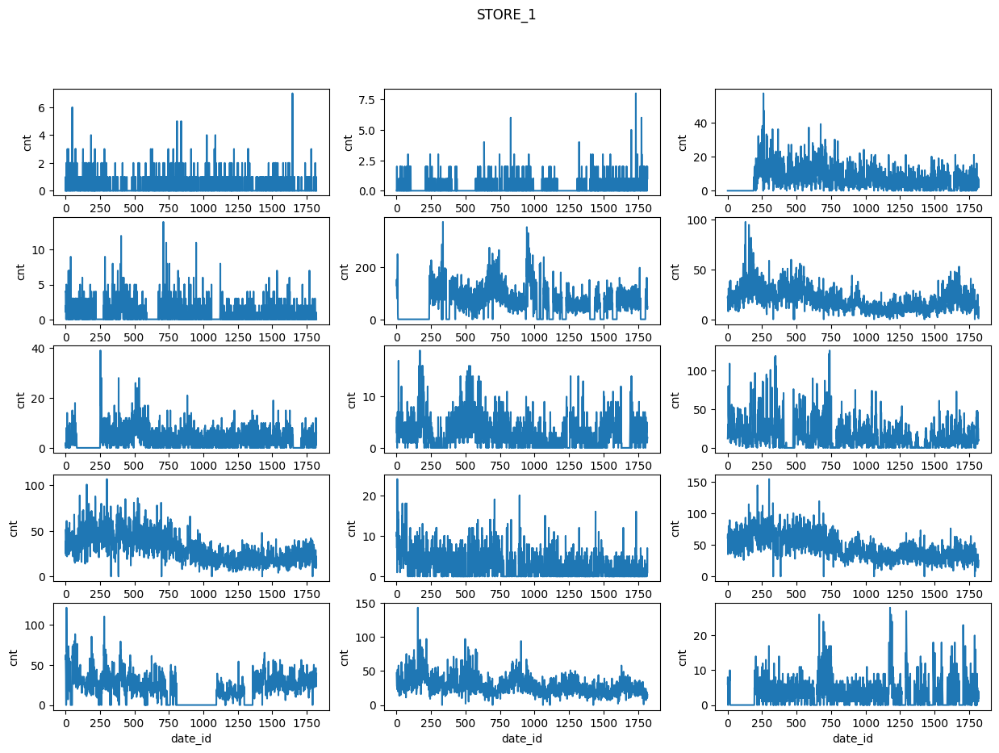

In [ ]:
fig,ax = plt.subplots(5,3,figsize=(15,10))

for i, art in enumerate(sales[sales.store_id=='STORE_1'].item_id.unique()):
    sns.lineplot(data = sales[(sales.item_id==art) & (sales.store_id=='STORE_1')],
                 x='date_id',y='cnt',ax = ax[i//3][i%3])
plt.suptitle("STORE_1")

In [ ]:
model = TimeSeriesClass(store, calendar, prices)

Product  STORE_1_064
{'trend': {'exists': True, 'p_value': 3.926018811104167e-05, 'slope': -0.00012481635286026776}, 'seasonality': {'exists': False, 'period': 30, 'amplitude': 0.36104519774011296}, 'stationarity': {'ADF': {'p_value': 2.7302921783158885e-22, 'stationary': True}, 'KPSS': {'p_value': 0.01, 'stationary': False}}, 'outliers': {'count': 25, 'indices': [Timestamp('2011-02-12 00:00:00'), Timestamp('2011-02-19 00:00:00'), Timestamp('2011-03-19 00:00:00'), Timestamp('2011-04-11 00:00:00'), Timestamp('2011-04-13 00:00:00'), Timestamp('2011-06-05 00:00:00'), Timestamp('2011-08-02 00:00:00'), Timestamp('2011-08-30 00:00:00'), Timestamp('2011-11-07 00:00:00'), Timestamp('2012-10-08 00:00:00'), Timestamp('2012-10-20 00:00:00'), Timestamp('2013-02-12 00:00:00'), Timestamp('2013-03-20 00:00:00'), Timestamp('2013-04-16 00:00:00'), Timestamp('2013-05-16 00:00:00'), Timestamp('2013-07-27 00:00:00'), Timestamp('2013-11-18 00:00:00'), Timestamp('2014-01-12 00:00:00'), Timestamp('2014-01-19

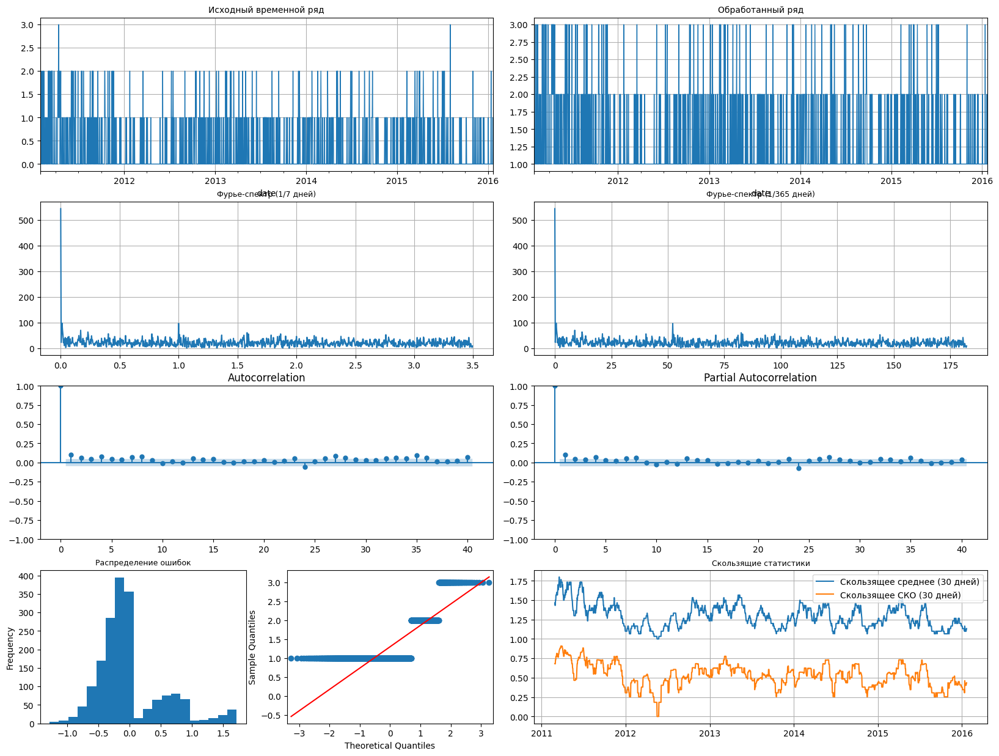

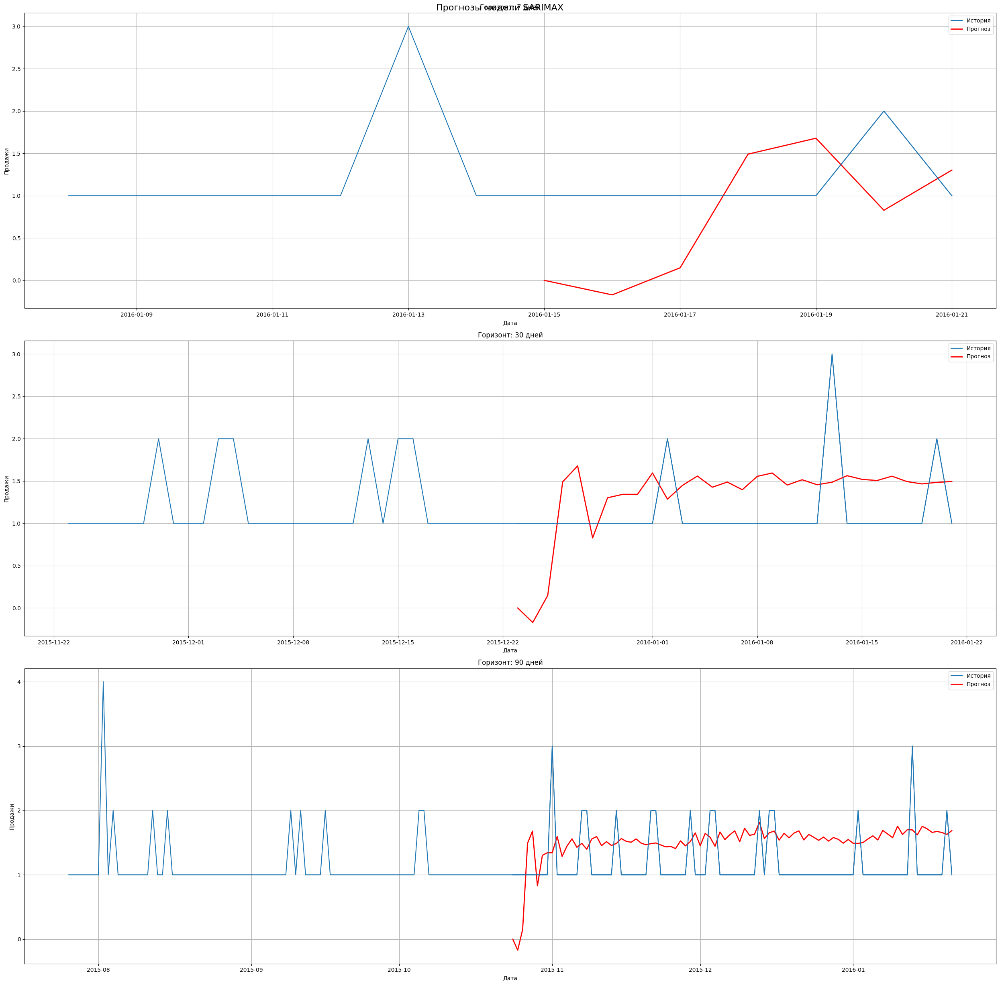

Model AutoARIMA for horizon 7

Best model:  ARIMA(1,0,1)(2,1,0)[7] intercept
Total fit time: 51.288 seconds
Model AutoARIMA for horizon 30

Best model:  ARIMA(1,0,1)(2,1,0)[7] intercept
Total fit time: 29.243 seconds
Model AutoARIMA for horizon 90

Best model:  ARIMA(1,0,1)(2,1,0)[7] intercept
Total fit time: 29.585 seconds


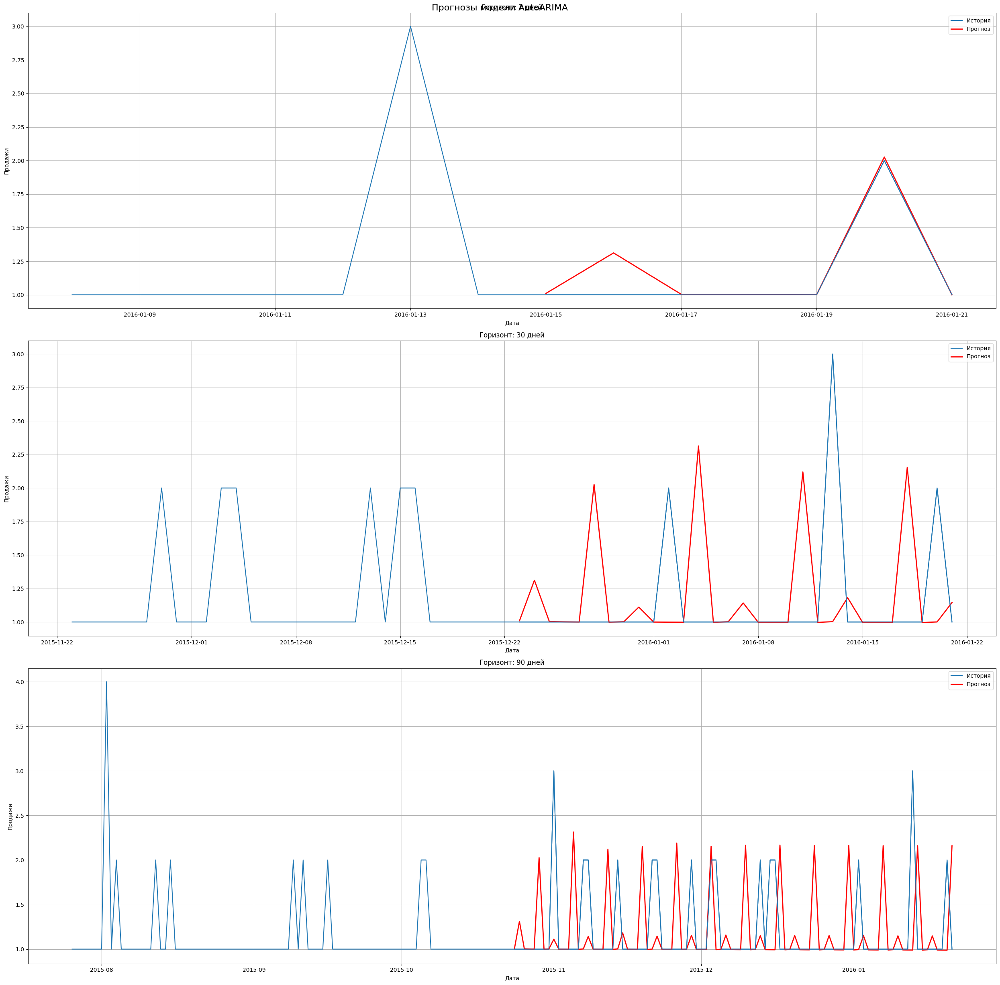

Model STL+ARIMA for horizon 7
Model STL+ARIMA for horizon 30
Model STL+ARIMA for horizon 90


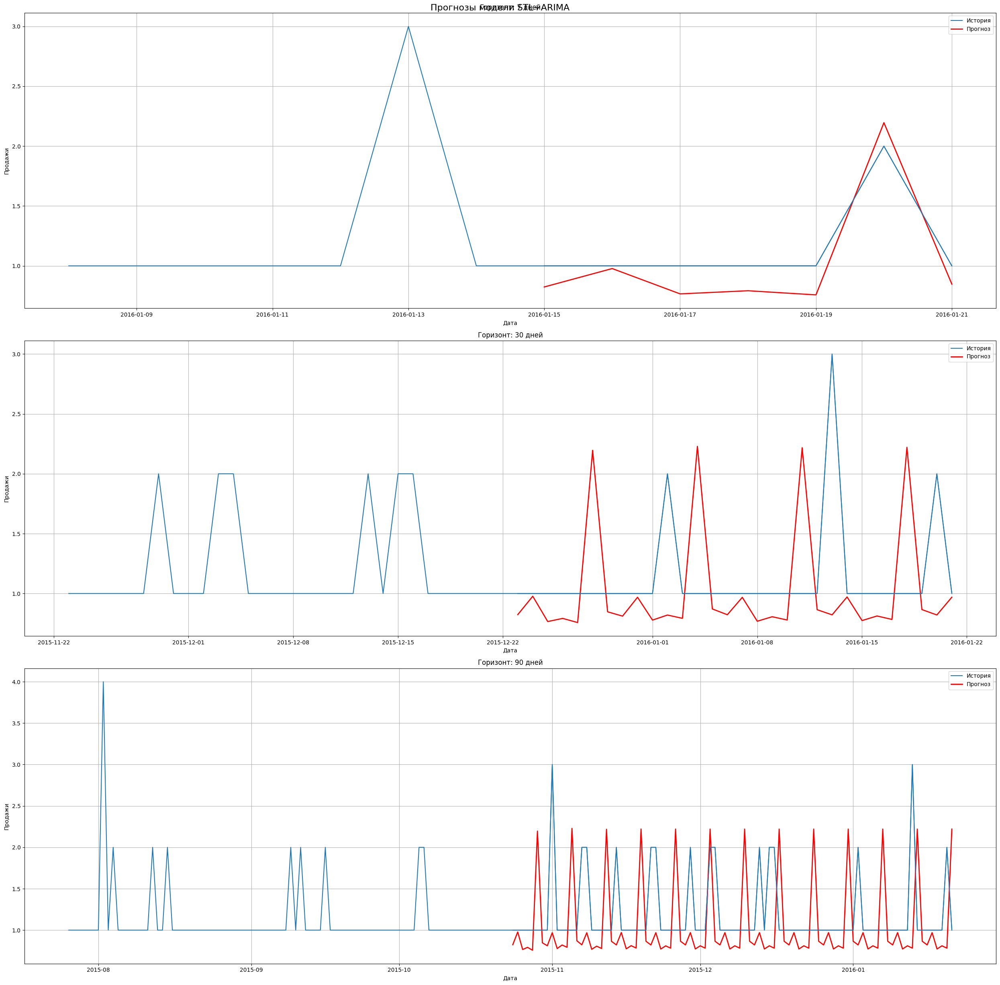

{('SARIMAX', 7): {'MAE': 0.8096720066800501, 'MAPE (%)': 72.59406866517367, 'RMSE': 0.8673189903402896}, ('SARIMAX', 30): {'MAE': 0.5728530332691087, 'MAPE (%)': 51.871075380448964, 'RMSE': 0.6290019399214282}, ('SARIMAX', 90): {'MAE': 0.5770262628645628, 'MAPE (%)': 52.26552780738815, 'RMSE': 0.6103263441251031}, ('AutoARIMA', 7): {'MAE': 0.05050636447258553, 'MAPE (%)': 4.863282513890798, 'RMSE': 0.11830466003193721}, ('AutoARIMA', 30): {'MAE': 0.31825344910383185, 'MAPE (%)': 24.05233369346873, 'RMSE': 0.620206511561373}, ('AutoARIMA', 90): {'MAE': 0.34582284393600043, 'MAPE (%)': 25.252504191540776, 'RMSE': 0.6245008334284489}, ('STL+ARIMA', 7): {'MAE': 0.17599931105314365, 'MAPE (%)': 16.199690664404752, 'RMSE': 0.1890202590507196}, ('STL+ARIMA', 30): {'MAE': 0.4343032576053075, 'MAPE (%)': 34.65867676836979, 'RMSE': 0.6865889148108458}, ('STL+ARIMA', 90): {'MAE': 0.4829688970604679, 'MAPE (%)': 37.47494033360683, 'RMSE': 0.7030263195758694}}
Product  STORE_1_065
{'trend': {'exist

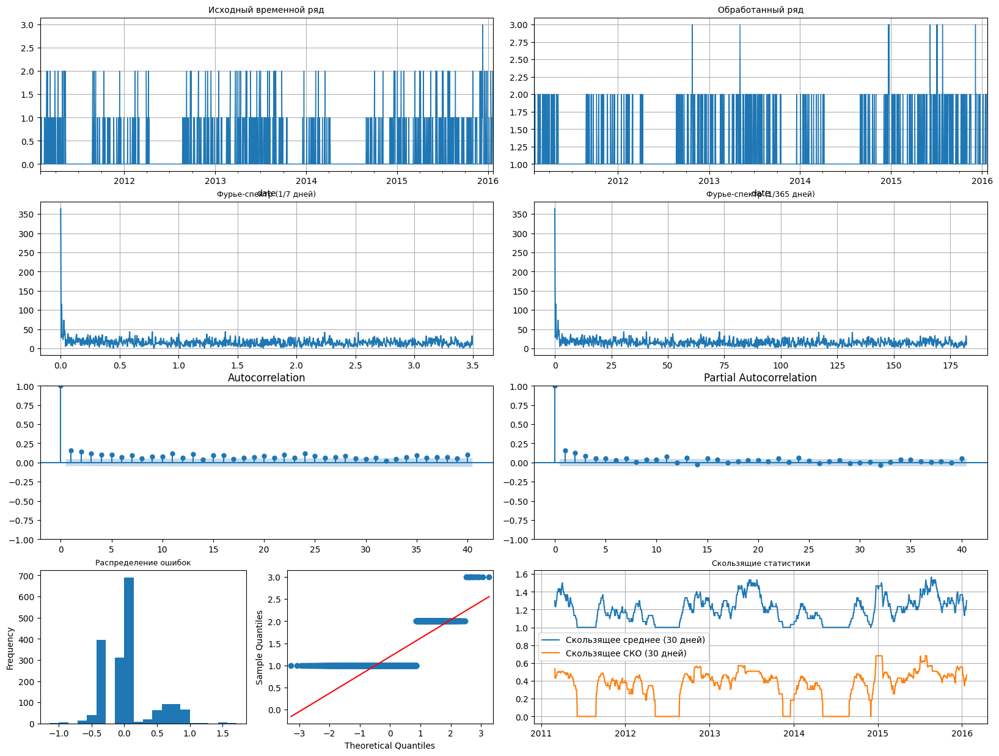

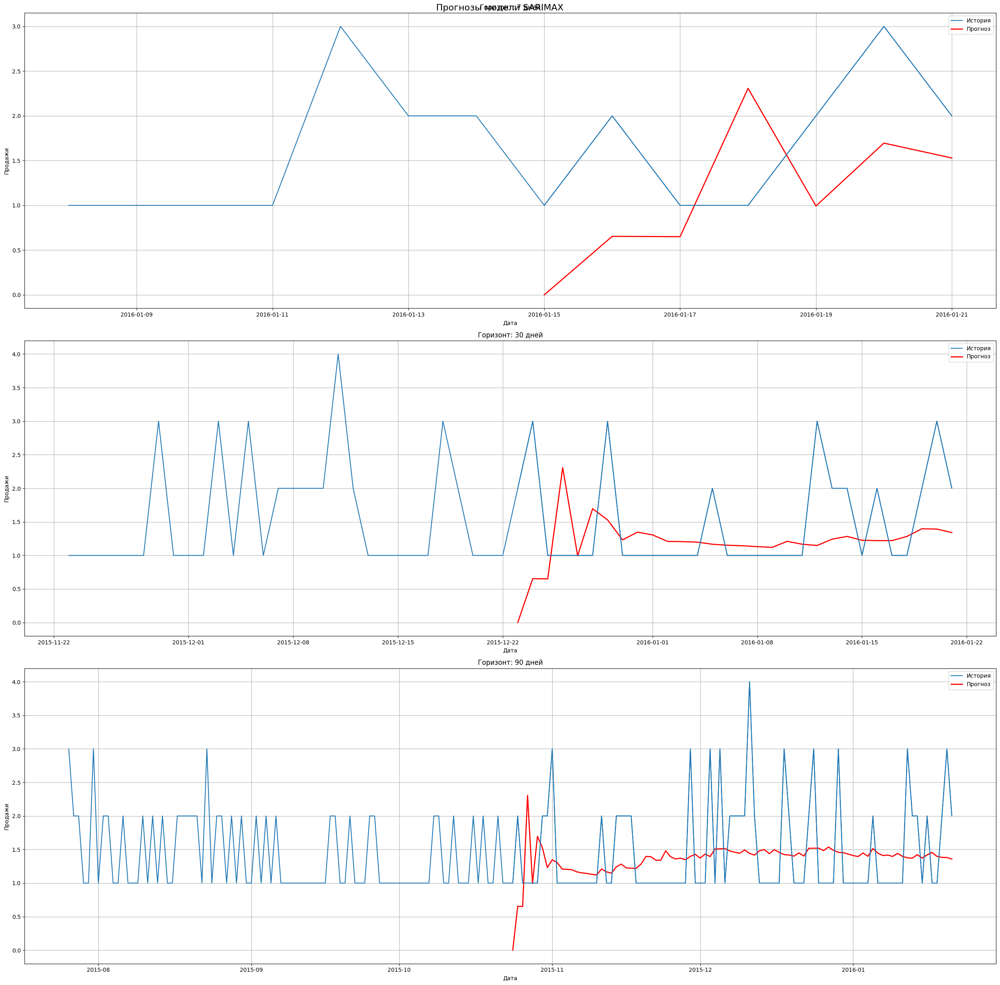

Model AutoARIMA for horizon 7

Best model:  ARIMA(1,0,1)(2,1,0)[7] intercept
Total fit time: 29.761 seconds
Model AutoARIMA for horizon 30

Best model:  ARIMA(1,0,1)(2,1,0)[7] intercept
Total fit time: 29.553 seconds
Model AutoARIMA for horizon 90

Best model:  ARIMA(1,0,1)(2,1,0)[7] intercept
Total fit time: 30.010 seconds


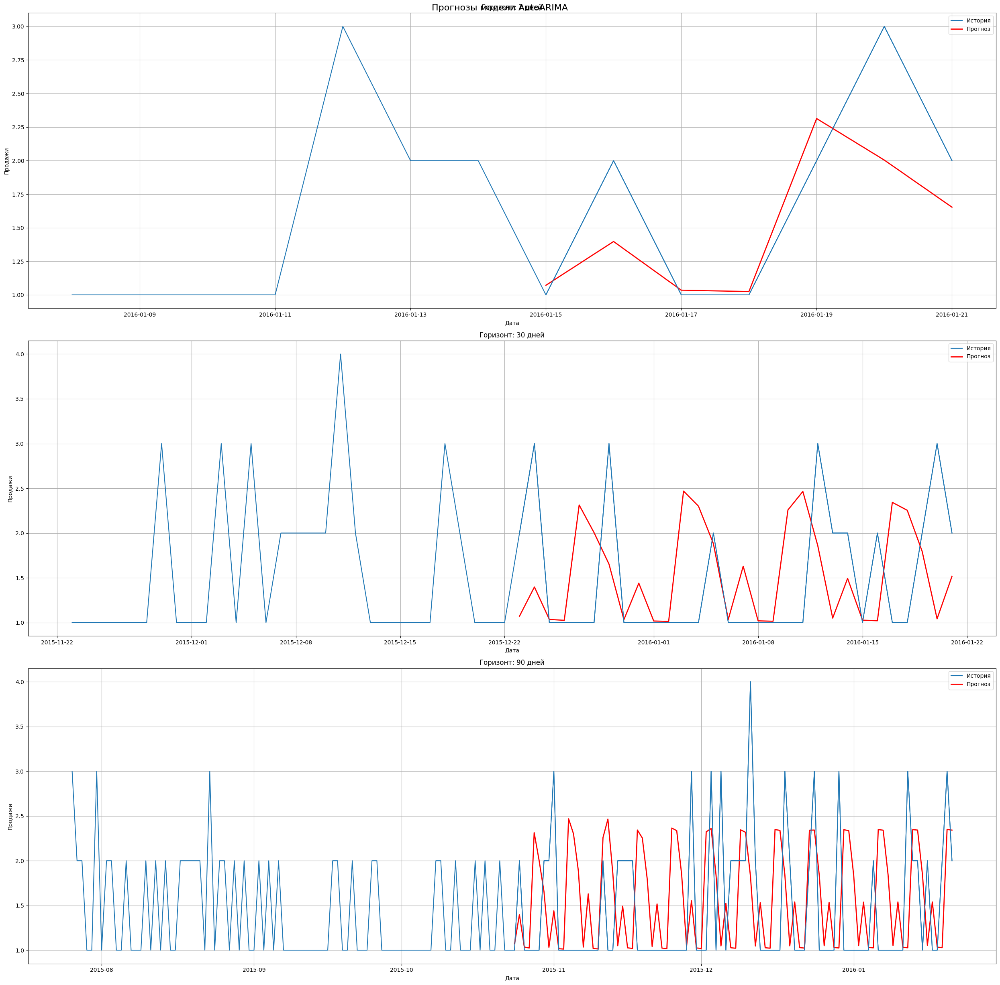

Model STL+ARIMA for horizon 7
Model STL+ARIMA for horizon 30
Model STL+ARIMA for horizon 90


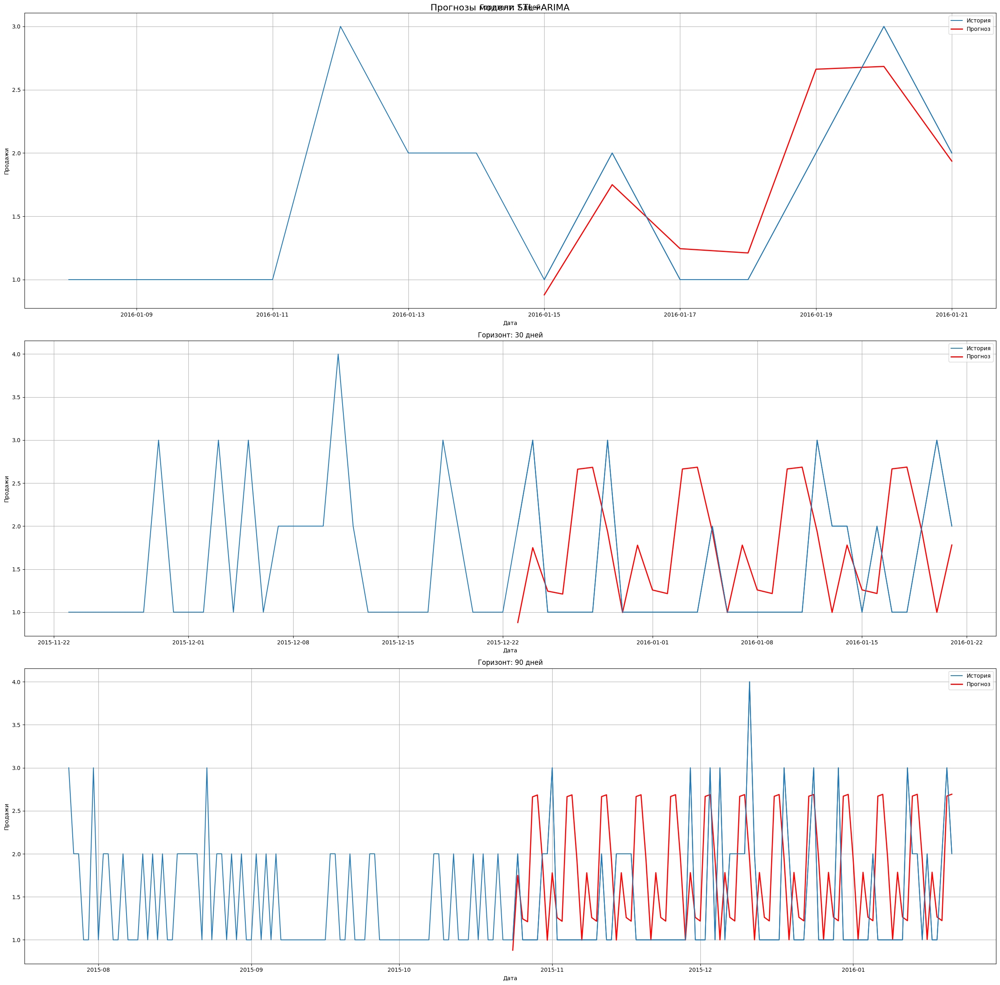

{('SARIMAX', 7): {'MAE': 0.9691692042000193, 'MAPE (%)': 64.3316346707494, 'RMSE': 1.0405313783164072}, ('SARIMAX', 30): {'MAE': 0.6378084821768559, 'MAPE (%)': 37.03064788359284, 'RMSE': 0.8926205349518604}, ('SARIMAX', 90): {'MAE': 0.5986512699669088, 'MAPE (%)': 39.60767405969784, 'RMSE': 0.7462543566234753}, ('AutoARIMA', 7): {'MAE': 0.3413888702666977, 'MAPE (%)': 15.634389896121517, 'RMSE': 0.47512968867685035}, ('AutoARIMA', 30): {'MAE': 0.730425202936955, 'MAPE (%)': 52.64808067056151, 'RMSE': 0.9499894179344944}, ('AutoARIMA', 90): {'MAE': 0.7004715732982385, 'MAPE (%)': 51.35529826285203, 'RMSE': 0.8982587502757409}, ('STL+ARIMA', 7): {'MAE': 0.26688313001771174, 'MAPE (%)': 16.70241403526085, 'RMSE': 0.32148920185095947}, ('STL+ARIMA', 30): {'MAE': 0.8491161551579398, 'MAPE (%)': 67.17580346081891, 'RMSE': 1.0778866826558948}, ('STL+ARIMA', 90): {'MAE': 0.8199809237953629, 'MAPE (%)': 64.60436059324434, 'RMSE': 1.0021115347162242}}
Product  STORE_1_325
{'trend': {'exists': T

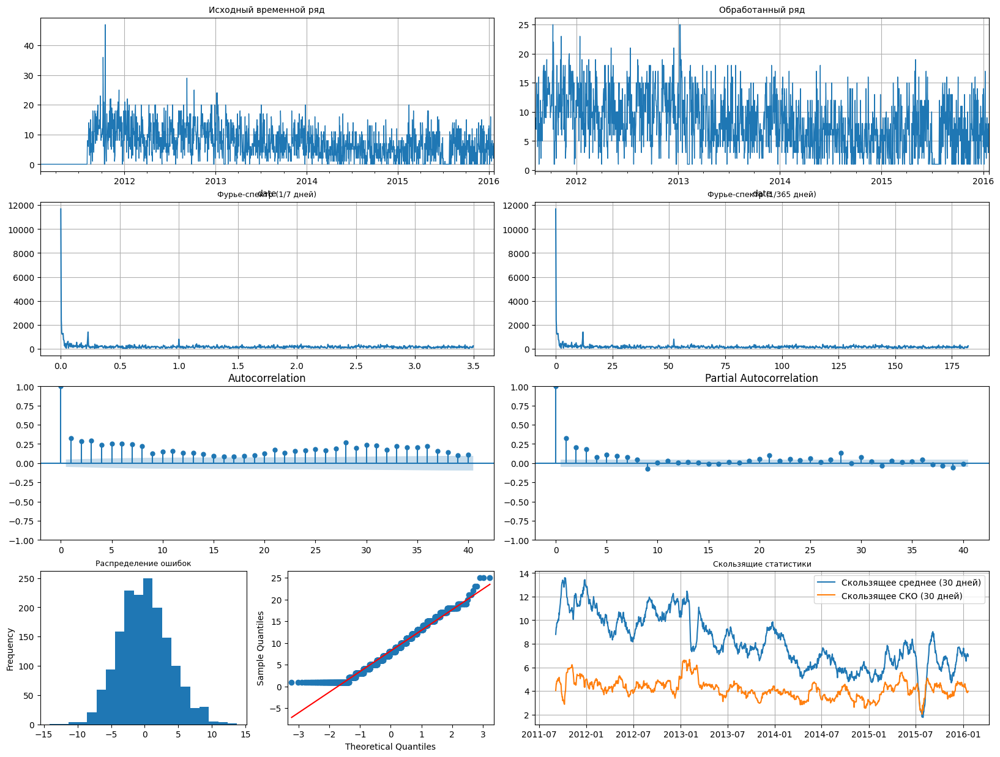

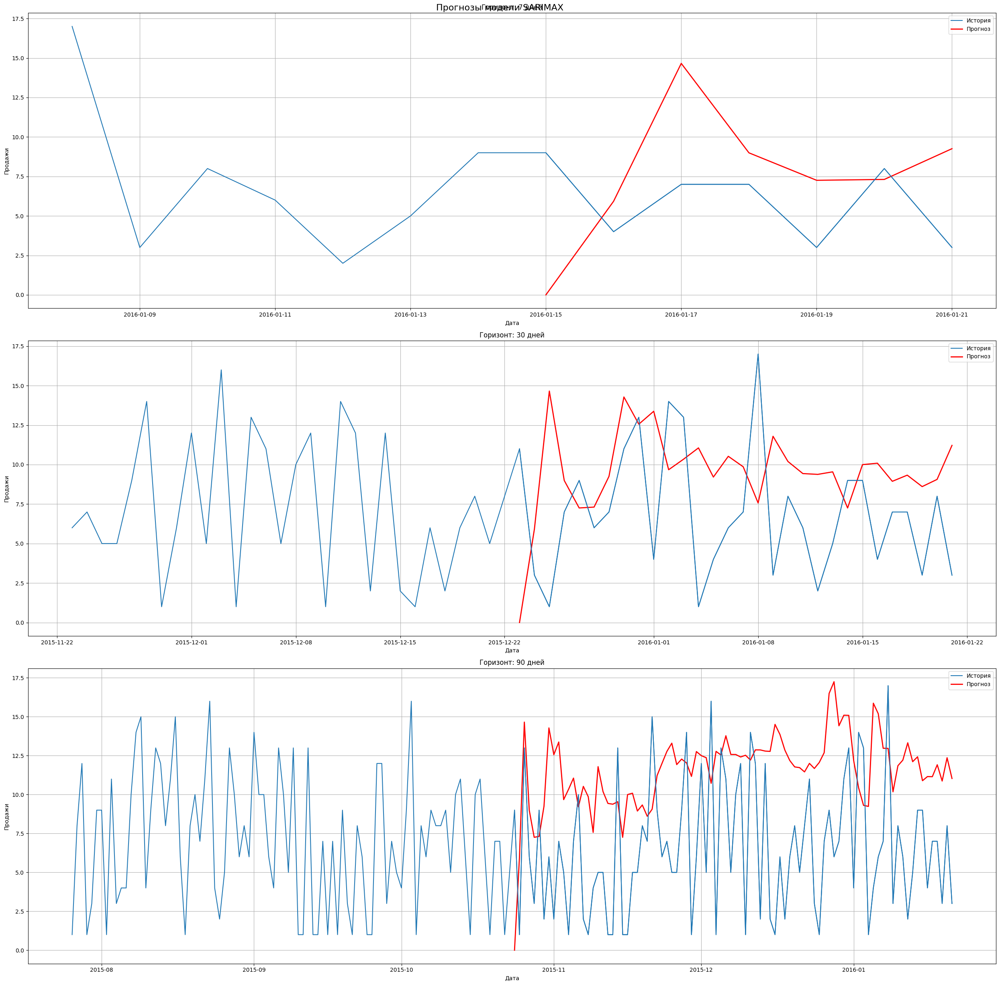

Model AutoARIMA for horizon 7

Best model:  ARIMA(1,0,1)(2,1,0)[7] intercept
Total fit time: 25.199 seconds
Model AutoARIMA for horizon 30

Best model:  ARIMA(1,0,1)(2,1,0)[7] intercept
Total fit time: 25.113 seconds
Model AutoARIMA for horizon 90

Best model:  ARIMA(1,0,1)(2,1,0)[7] intercept
Total fit time: 25.541 seconds


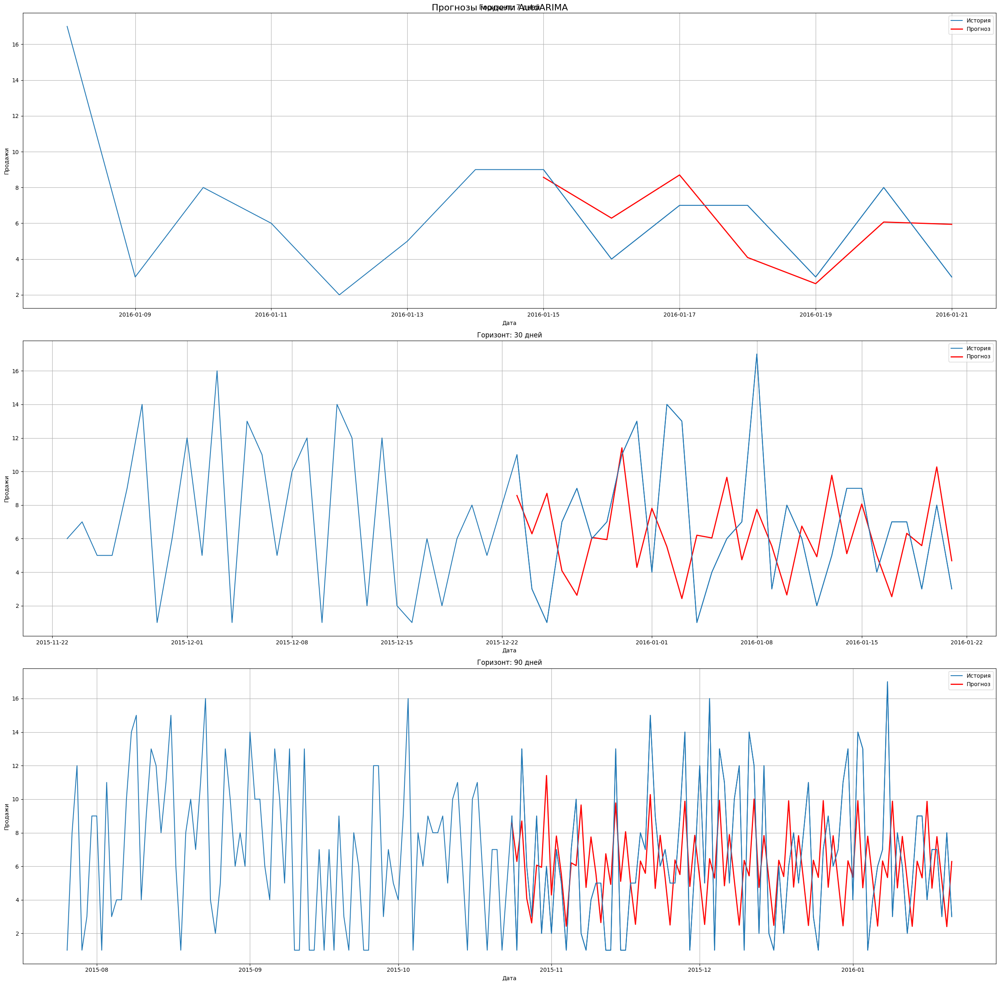

Model STL+ARIMA for horizon 7
Model STL+ARIMA for horizon 30
Model STL+ARIMA for horizon 90


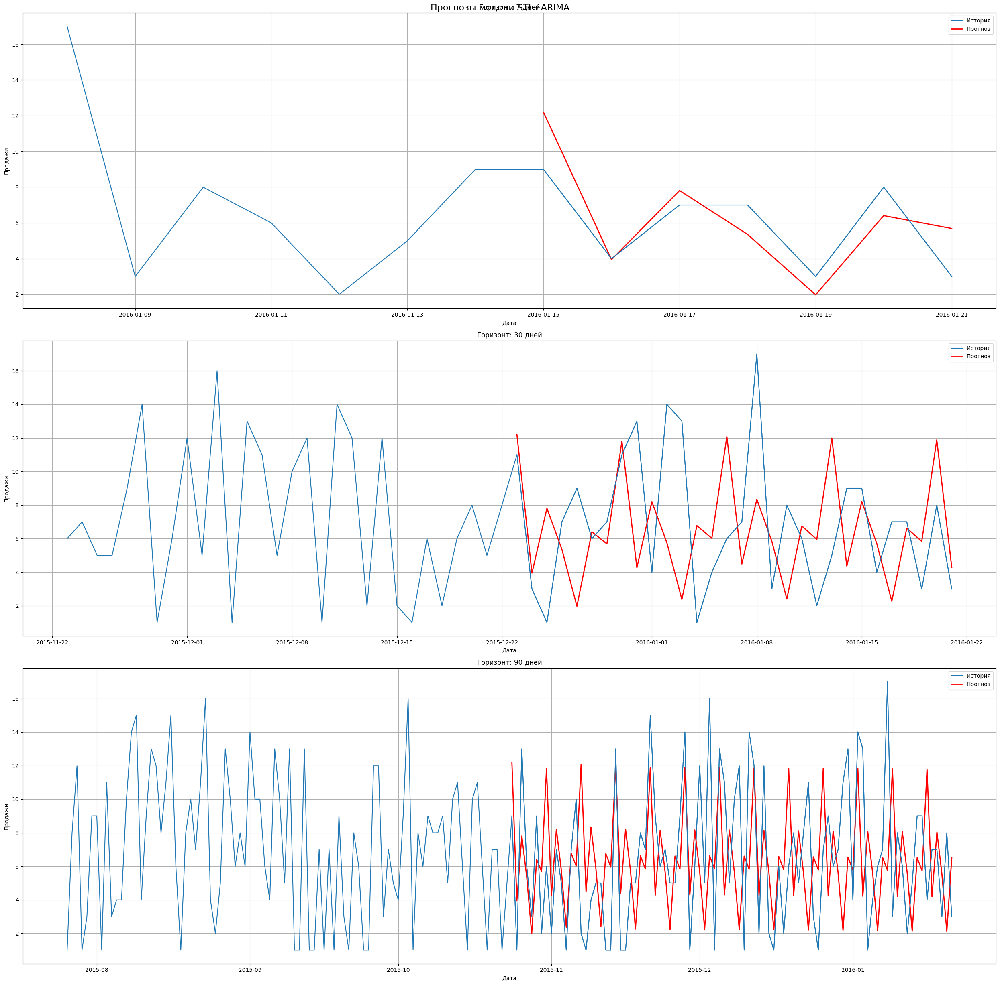

{('SARIMAX', 7): {'MAE': 4.539758981193808, 'MAPE (%)': 92.14678874738779, 'RMSE': 5.412208201824072}, ('SARIMAX', 30): {'MAE': 4.713480968093335, 'MAPE (%)': 161.5926986456881, 'RMSE': 5.831013195235168}, ('SARIMAX', 90): {'MAE': 5.9162683256759045, 'MAPE (%)': 240.59097707046635, 'RMSE': 6.739471643454534}, ('AutoARIMA', 7): {'MAE': 1.7966242894418158, 'MAPE (%)': 37.5021809293828, 'RMSE': 2.046272607147007}, ('AutoARIMA', 30): {'MAE': 3.736430042287119, 'MAPE (%)': 92.87325265345422, 'RMSE': 4.672331410878807}, ('AutoARIMA', 90): {'MAE': 3.6576272424975382, 'MAPE (%)': 114.18965444043036, 'RMSE': 4.359025063604261}, ('STL+ARIMA', 7): {'MAE': 1.5734839263428755, 'MAPE (%)': 30.80802781819672, 'RMSE': 1.867253987796806}, ('STL+ARIMA', 30): {'MAE': 3.9128036394619854, 'MAPE (%)': 95.45574115745033, 'RMSE': 4.86633423938105}, ('STL+ARIMA', 90): {'MAE': 3.7398865935793517, 'MAPE (%)': 117.37432279174789, 'RMSE': 4.521595111891701}}
Product  STORE_1_376
{'trend': {'exists': True, 'p_value

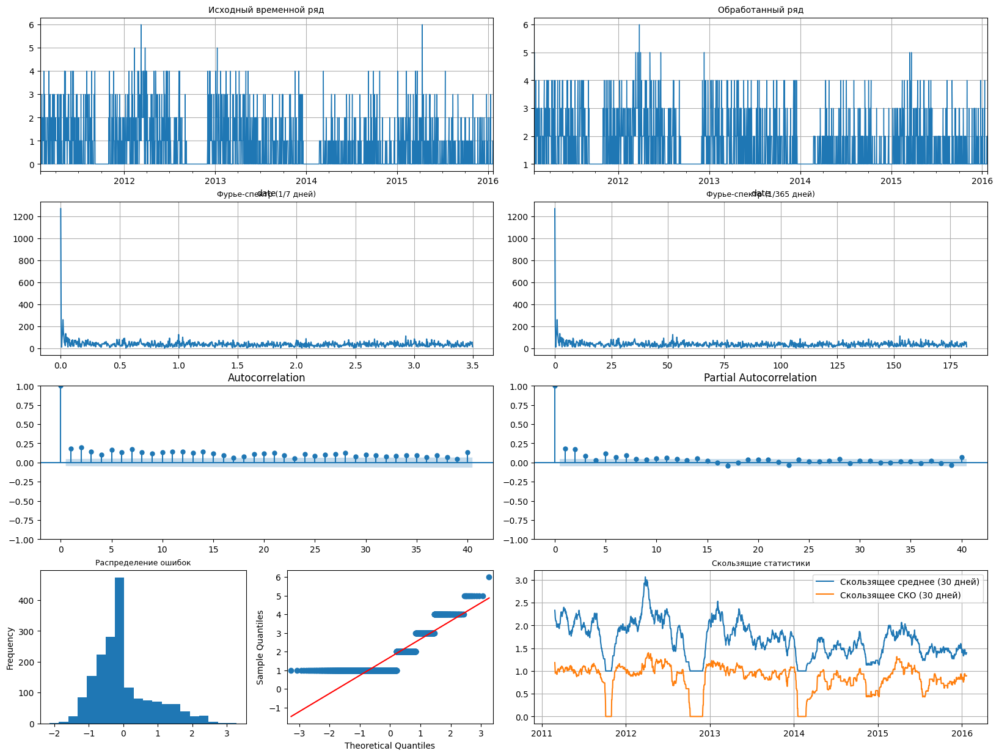

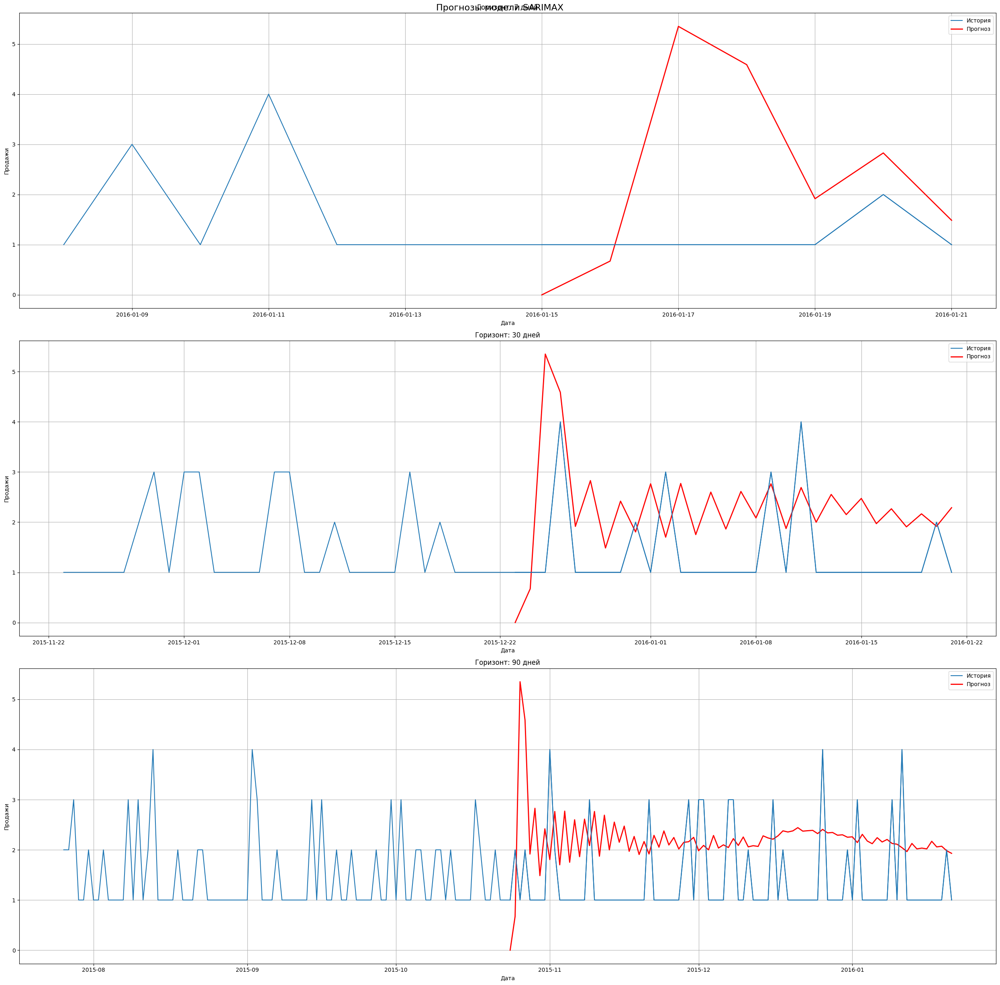

Model AutoARIMA for horizon 7

Best model:  ARIMA(0,0,0)(0,1,1)[7] intercept
Total fit time: 28.865 seconds
Model AutoARIMA for horizon 30

Best model:  ARIMA(0,0,0)(0,1,1)[7] intercept
Total fit time: 29.879 seconds
Model AutoARIMA for horizon 90

Best model:  ARIMA(0,0,0)(0,1,1)[7] intercept
Total fit time: 29.704 seconds


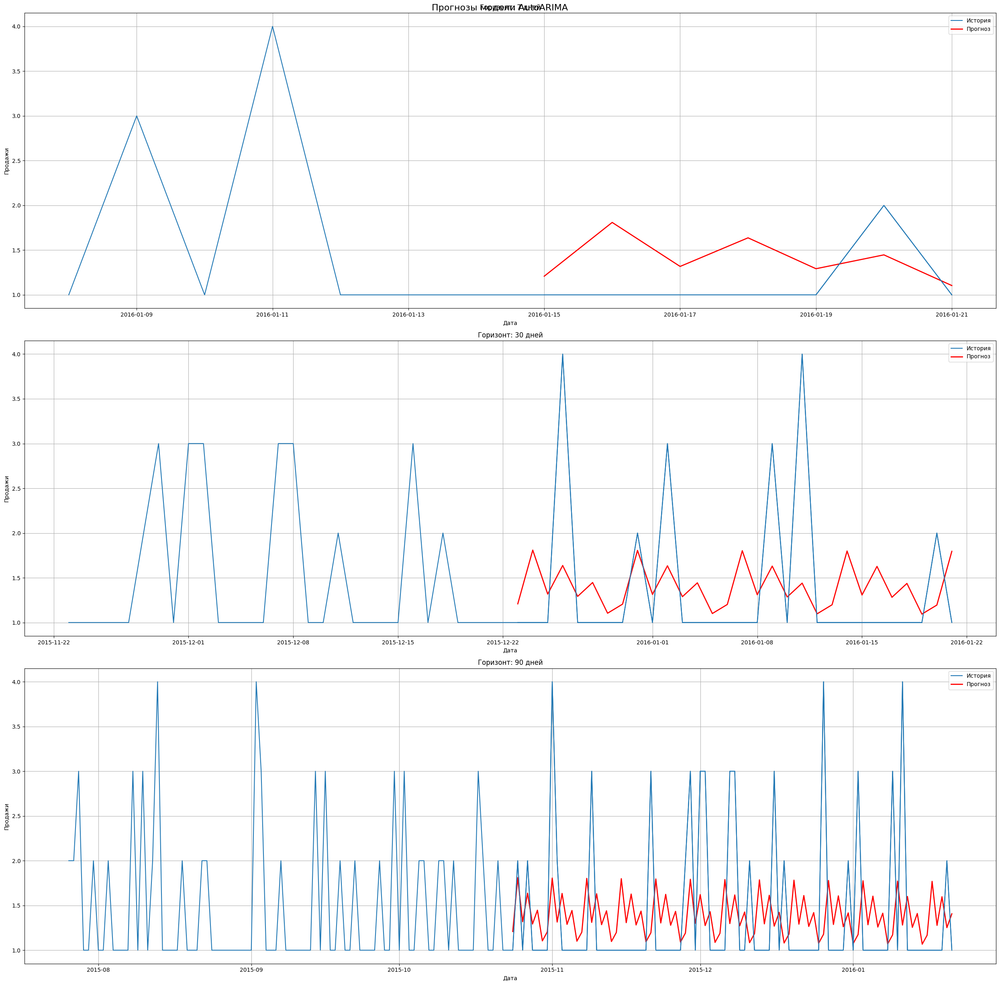

Model STL+ARIMA for horizon 7
Model STL+ARIMA for horizon 30
Model STL+ARIMA for horizon 90


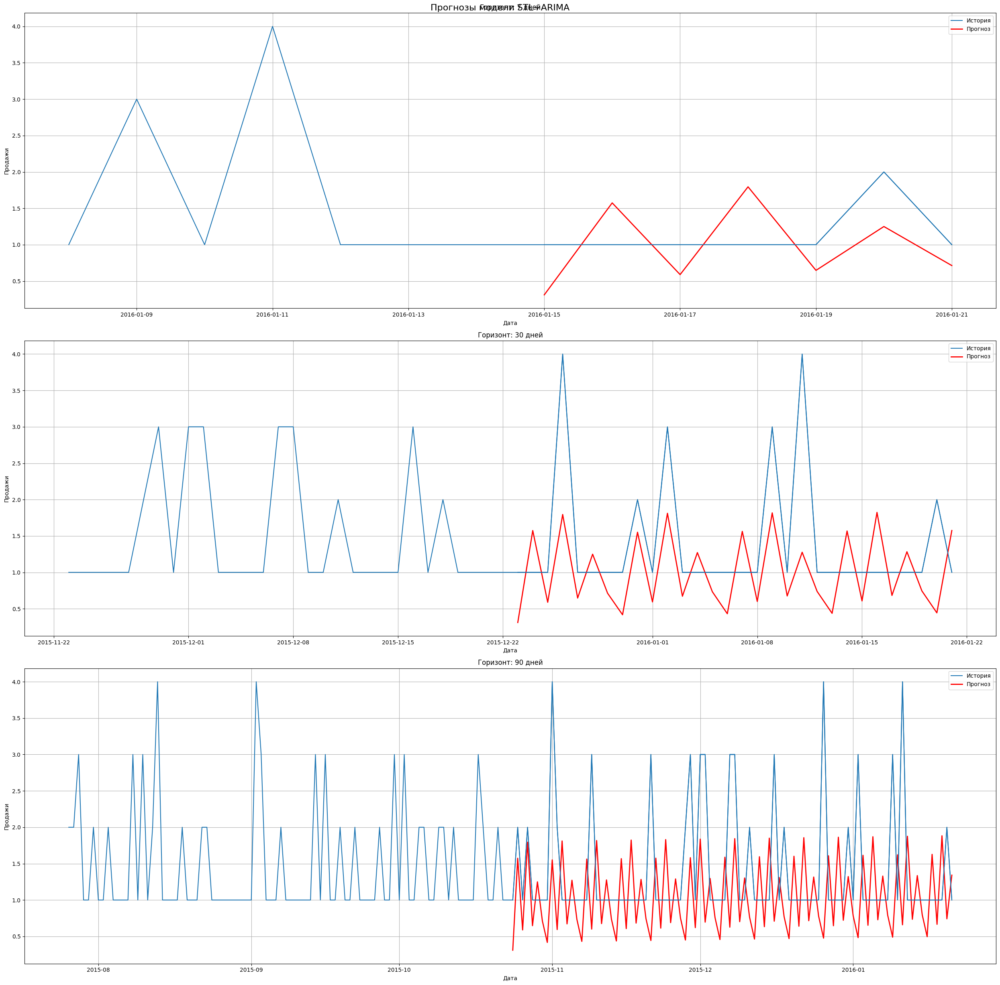

{('SARIMAX', 7): {'MAE': 1.6419730329719489, 'MAPE (%)': 158.282240865702, 'RMSE': 2.2251130287309655}, ('SARIMAX', 30): {'MAE': 1.1709420221998443, 'MAPE (%)': 108.48154091447697, 'RMSE': 1.3934893888551285}, ('SARIMAX', 90): {'MAE': 1.1814601066377477, 'MAPE (%)': 103.60828369781107, 'RMSE': 1.2905711997599565}, ('AutoARIMA', 7): {'MAE': 0.41754745422203215, 'MAPE (%)': 37.804779727157175, 'RMSE': 0.4793058771428323}, ('AutoARIMA', 30): {'MAE': 0.5810015110688788, 'MAPE (%)': 38.051895592636136, 'RMSE': 0.8374546549415404}, ('AutoARIMA', 90): {'MAE': 0.6240785604843606, 'MAPE (%)': 41.011531761569685, 'RMSE': 0.8500337637018115}, ('STL+ARIMA', 7): {'MAE': 0.5514926790351635, 'MAPE (%)': 49.79041620166777, 'RMSE': 0.5827118541758619}, ('STL+ARIMA', 30): {'MAE': 0.6539635265157163, 'MAPE (%)': 44.46698975470661, 'RMSE': 0.8705261092035081}, ('STL+ARIMA', 90): {'MAE': 0.7702761126997686, 'MAPE (%)': 49.505720129810896, 'RMSE': 1.0658621162171007}}
Product  STORE_1_090
{'trend': {'exists

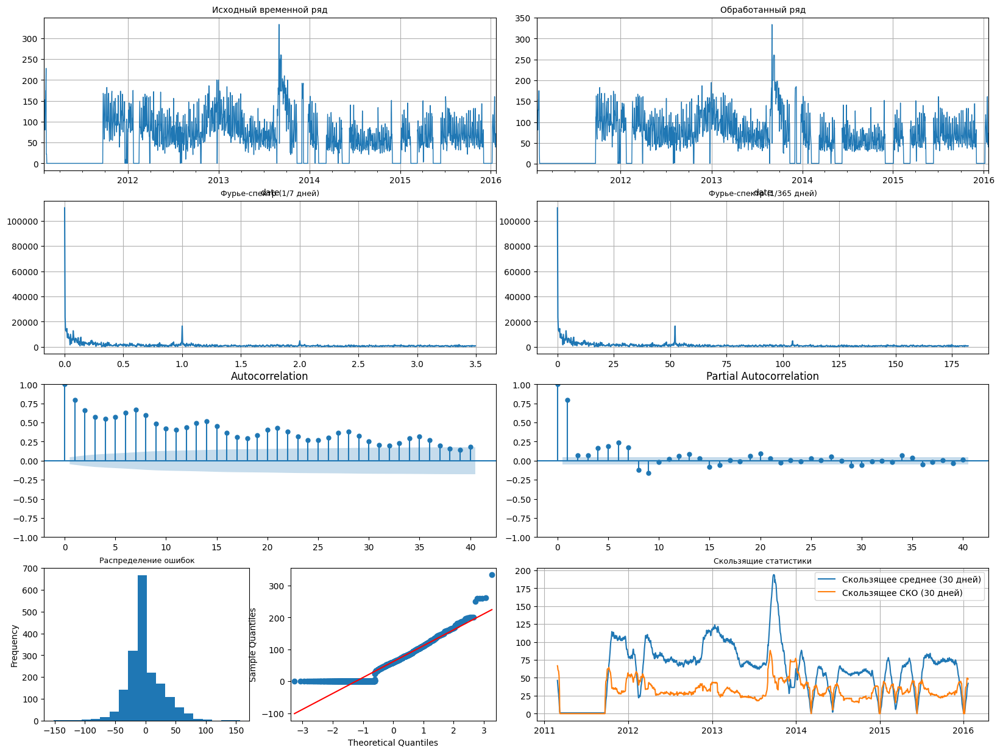

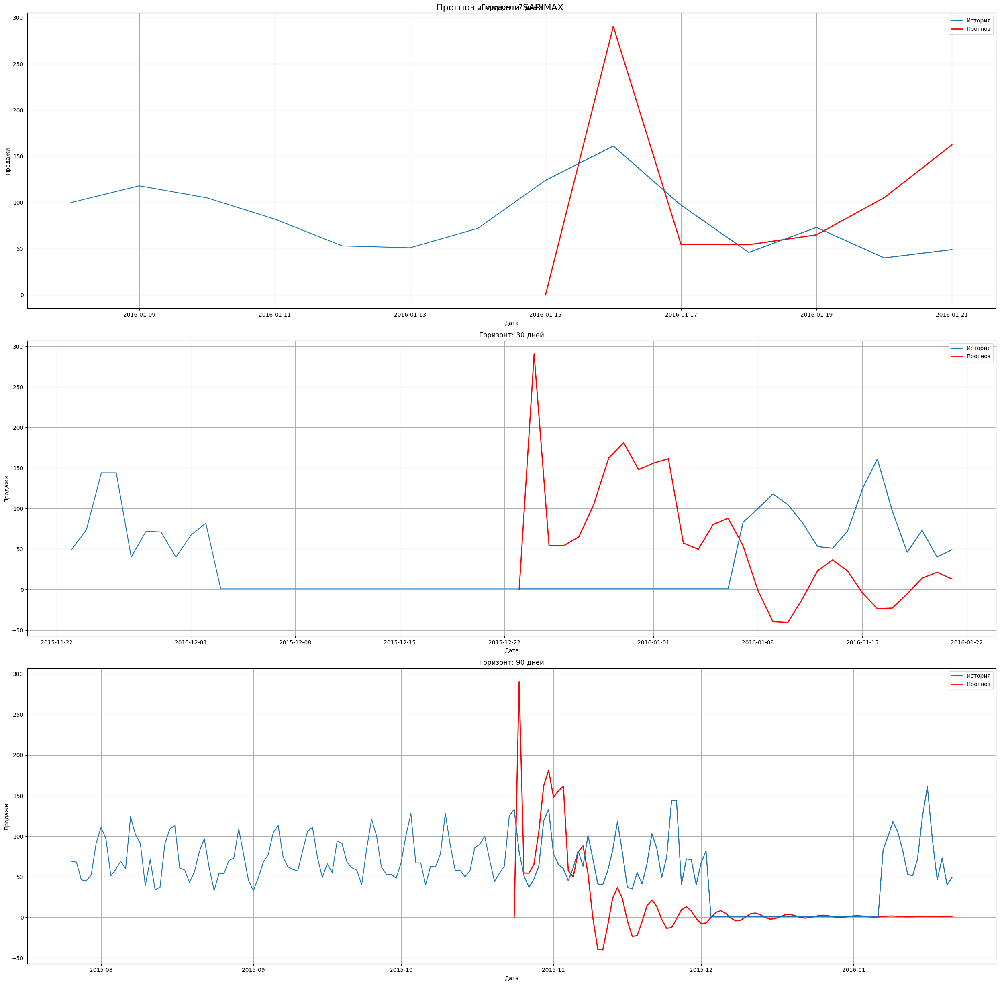

Model AutoARIMA for horizon 7

Best model:  ARIMA(2,0,0)(0,1,1)[7] intercept
Total fit time: 29.538 seconds
Model AutoARIMA for horizon 30

Best model:  ARIMA(2,0,0)(0,1,1)[7] intercept
Total fit time: 30.143 seconds
Model AutoARIMA for horizon 90

Best model:  ARIMA(2,0,0)(0,1,1)[7] intercept
Total fit time: 29.929 seconds


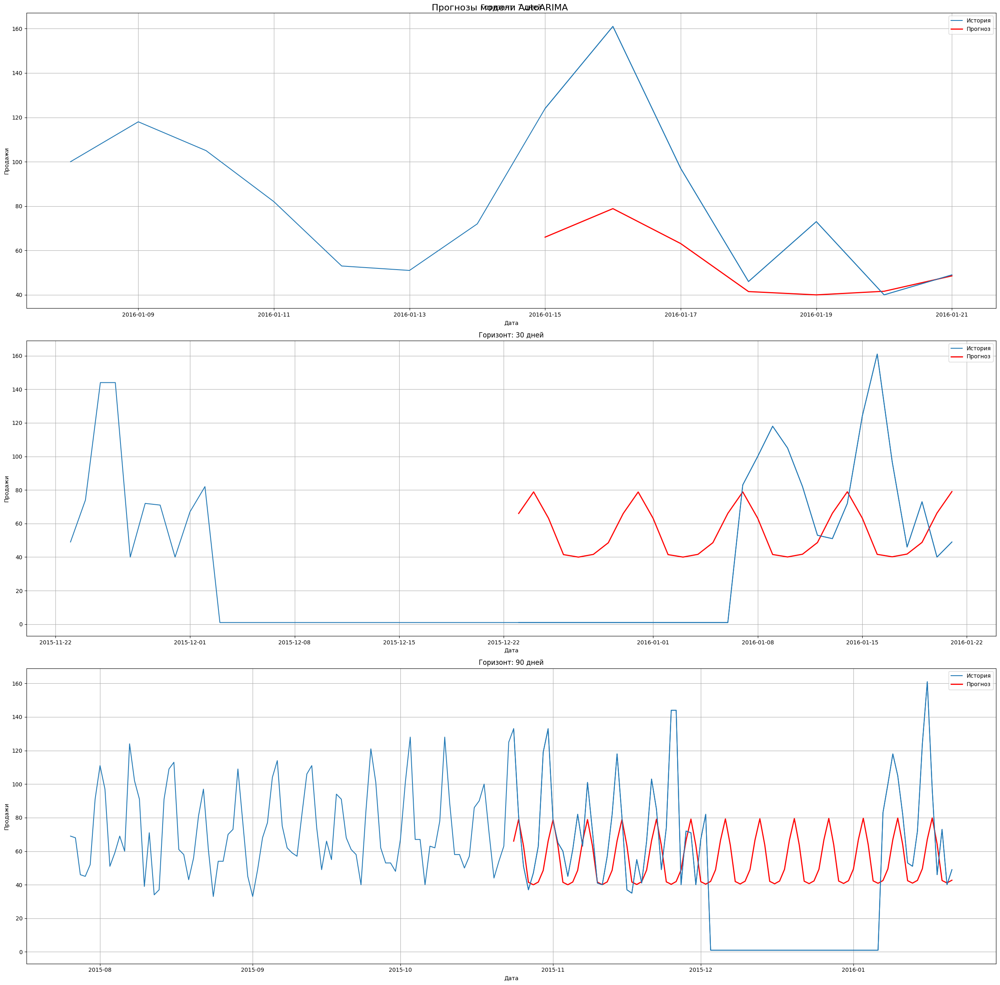

Model STL+ARIMA for horizon 7
Model STL+ARIMA for horizon 30
Model STL+ARIMA for horizon 90


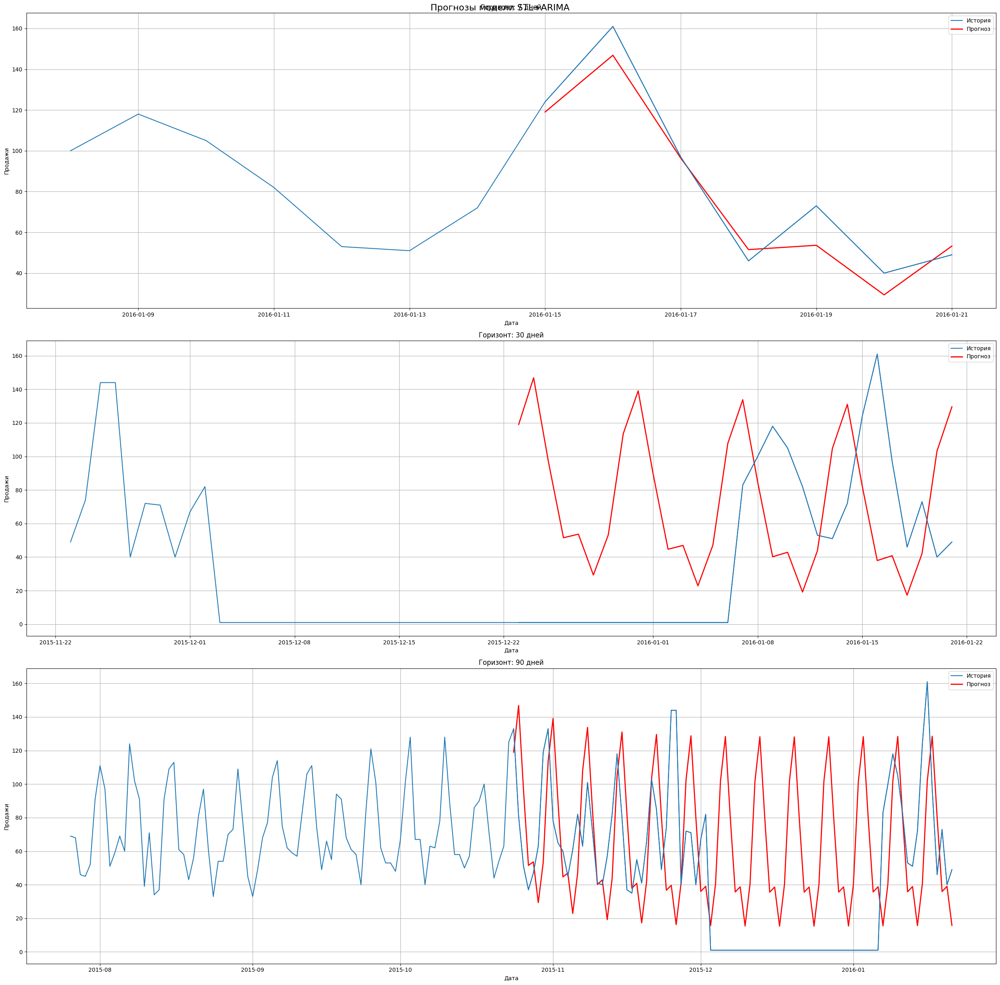

{('SARIMAX', 7): {'MAE': 70.1269563683427, 'MAPE (%)': 92.52630558354392, 'RMSE': 85.51160649086069}, ('SARIMAX', 30): {'MAE': 95.22003721848753, 'MAPE (%)': 5513.660723592357, 'RMSE': 114.81130039889902}, ('SARIMAX', 90): {'MAE': 43.44745620693739, 'MAPE (%)': 133.32877010821096, 'RMSE': 63.03396731294112}, ('AutoARIMA', 7): {'MAE': 30.517352435096118, 'MAPE (%)': 27.53298281969357, 'RMSE': 42.04061793868853}, ('AutoARIMA', 30): {'MAE': 46.03041971250387, 'MAPE (%)': 2721.3121547081055, 'RMSE': 52.715869291146724}, ('AutoARIMA', 90): {'MAE': 36.693525631083304, 'MAPE (%)': 2112.3506387557554, 'RMSE': 45.02644831569766}, ('STL+ARIMA', 7): {'MAE': 8.504662773960973, 'MAPE (%)': 12.47680723581609, 'RMSE': 10.436020135834843}, ('STL+ARIMA', 30): {'MAE': 65.39869679580936, 'MAPE (%)': 3858.422883280888, 'RMSE': 74.4345726397046}, ('STL+ARIMA', 90): {'MAE': 44.79534433165438, 'MAPE (%)': 2431.7513513750696, 'RMSE': 56.223787423854695}}
Product  STORE_1_252
{'trend': {'exists': True, 'p_valu

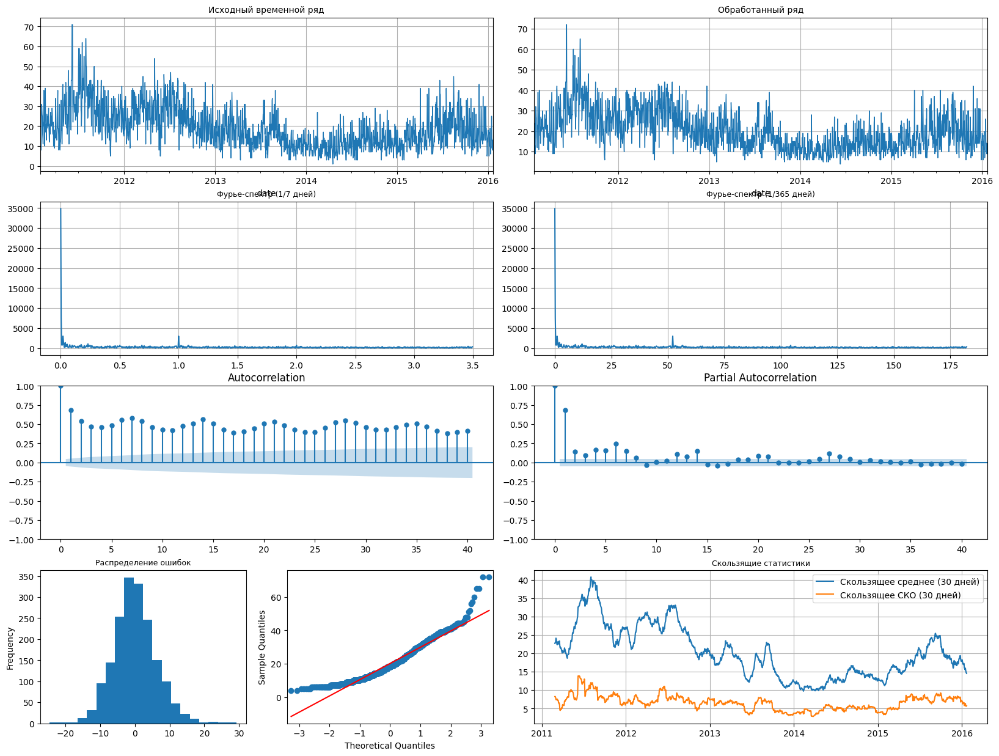

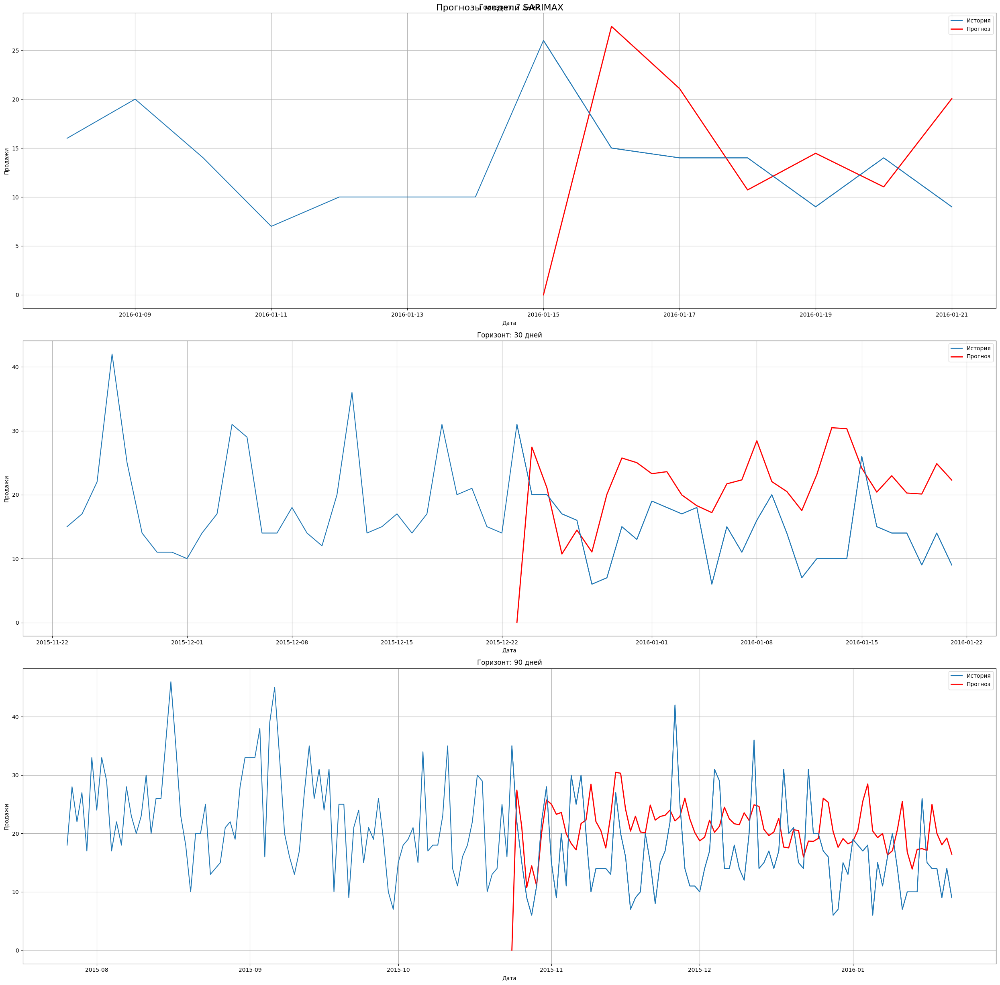

Model AutoARIMA for horizon 7

Best model:  ARIMA(1,0,1)(1,1,1)[7] intercept
Total fit time: 30.211 seconds
Model AutoARIMA for horizon 30

Best model:  ARIMA(1,0,1)(1,1,1)[7] intercept
Total fit time: 29.489 seconds
Model AutoARIMA for horizon 90

Best model:  ARIMA(1,0,1)(1,1,1)[7] intercept
Total fit time: 28.672 seconds


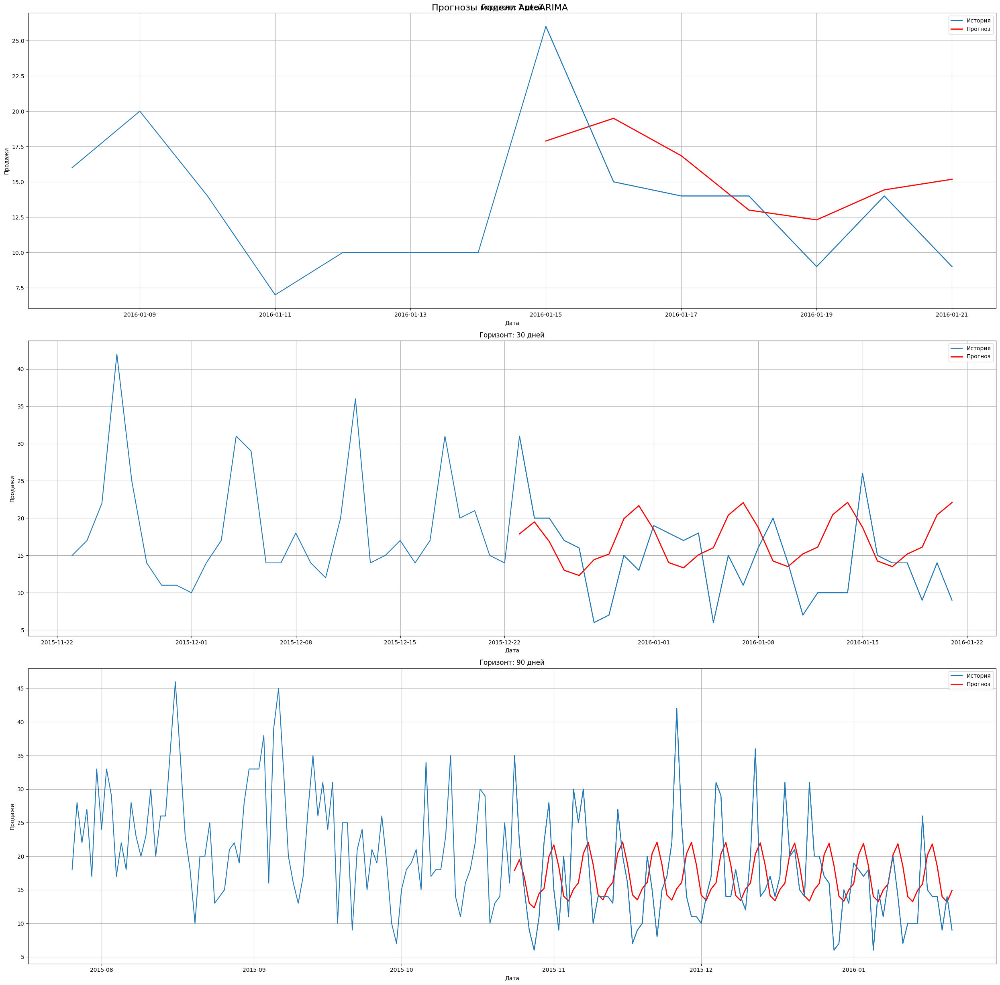

Model STL+ARIMA for horizon 7
Model STL+ARIMA for horizon 30
Model STL+ARIMA for horizon 90


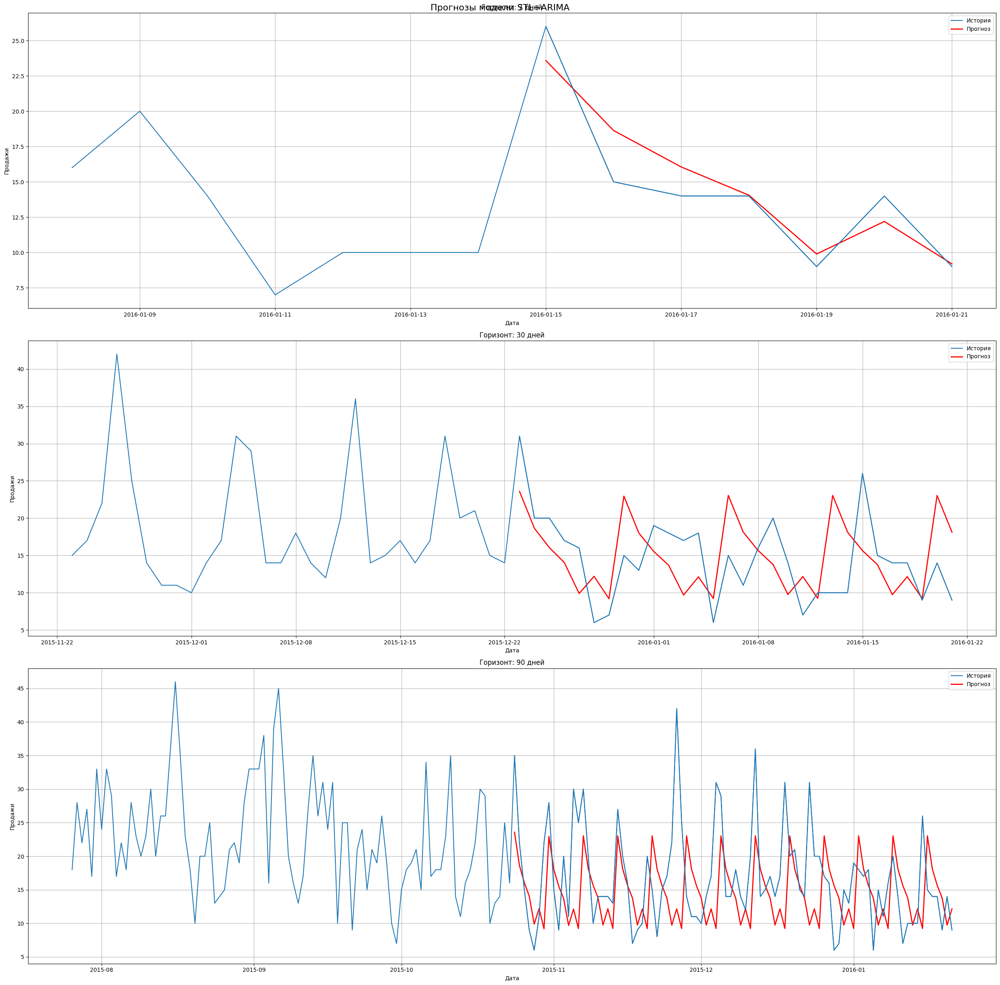

{('SARIMAX', 7): {'MAE': 9.751347947429307, 'MAPE (%)': 65.92058140845657, 'RMSE': 12.25906244944501}, ('SARIMAX', 30): {'MAE': 9.12163221303565, 'MAPE (%)': 78.48483210600486, 'RMSE': 11.191626138425141}, ('SARIMAX', 90): {'MAE': 7.655682338055789, 'MAPE (%)': 58.6498993508326, 'RMSE': 9.303992347298847}, ('AutoARIMA', 7): {'MAE': 3.767214703612869, 'MAPE (%)': 28.162932216290535, 'RMSE': 4.541613443424402}, ('AutoARIMA', 30): {'MAE': 5.812953099537592, 'MAPE (%)': 53.298457047222456, 'RMSE': 6.971924158206371}, ('AutoARIMA', 90): {'MAE': 5.708406816052895, 'MAPE (%)': 39.51448662575617, 'RMSE': 7.404153399412905}, ('STL+ARIMA', 7): {'MAE': 1.577231937978363, 'MAPE (%)': 10.494424673613377, 'RMSE': 1.9762410546318792}, ('STL+ARIMA', 30): {'MAE': 5.215908736707936, 'MAPE (%)': 41.29399015694064, 'RMSE': 6.082078232815657}, ('STL+ARIMA', 90): {'MAE': 6.059206011145045, 'MAPE (%)': 37.54431741796227, 'RMSE': 8.208566369983833}}
Product  STORE_1_339
{'trend': {'exists': True, 'p_value': 7

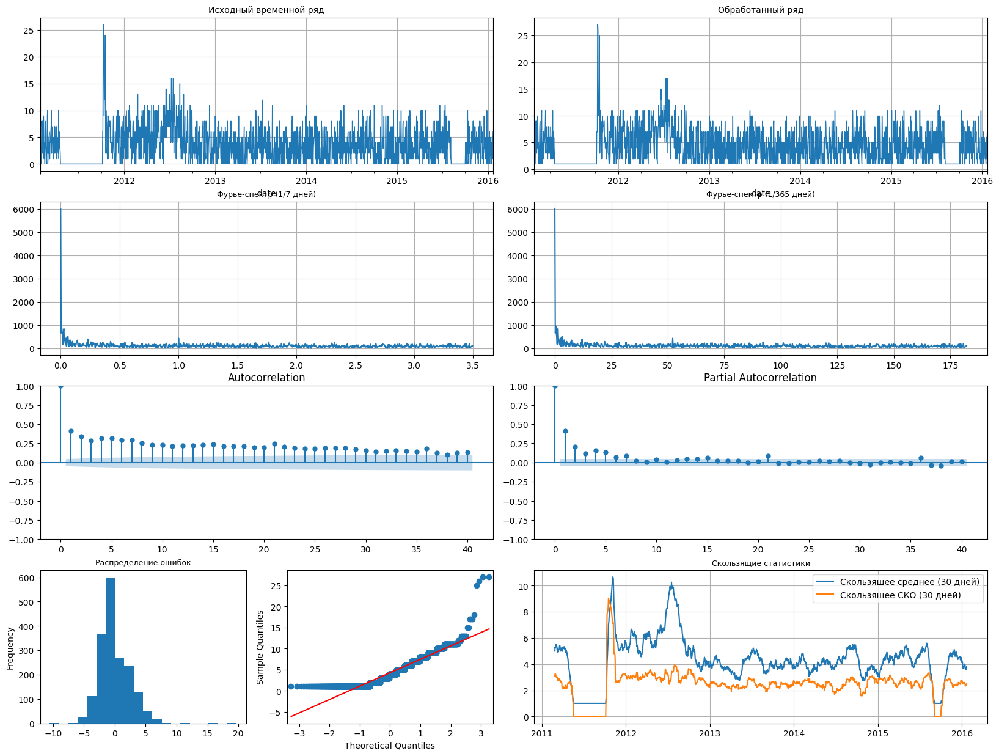

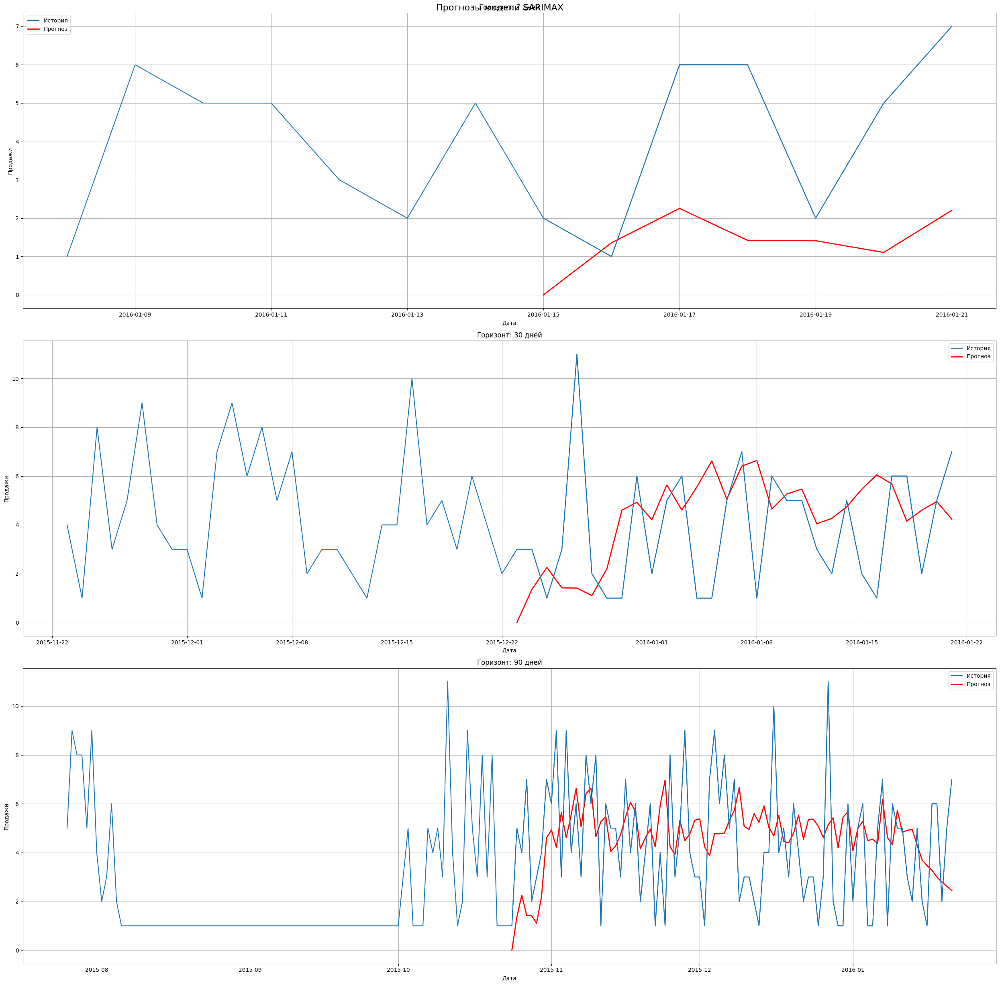

Model AutoARIMA for horizon 7

Best model:  ARIMA(0,0,4)(0,1,1)[7] intercept
Total fit time: 28.258 seconds
Model AutoARIMA for horizon 30

Best model:  ARIMA(0,0,4)(0,1,1)[7] intercept
Total fit time: 28.882 seconds
Model AutoARIMA for horizon 90

Best model:  ARIMA(0,0,4)(0,1,1)[7] intercept
Total fit time: 28.969 seconds


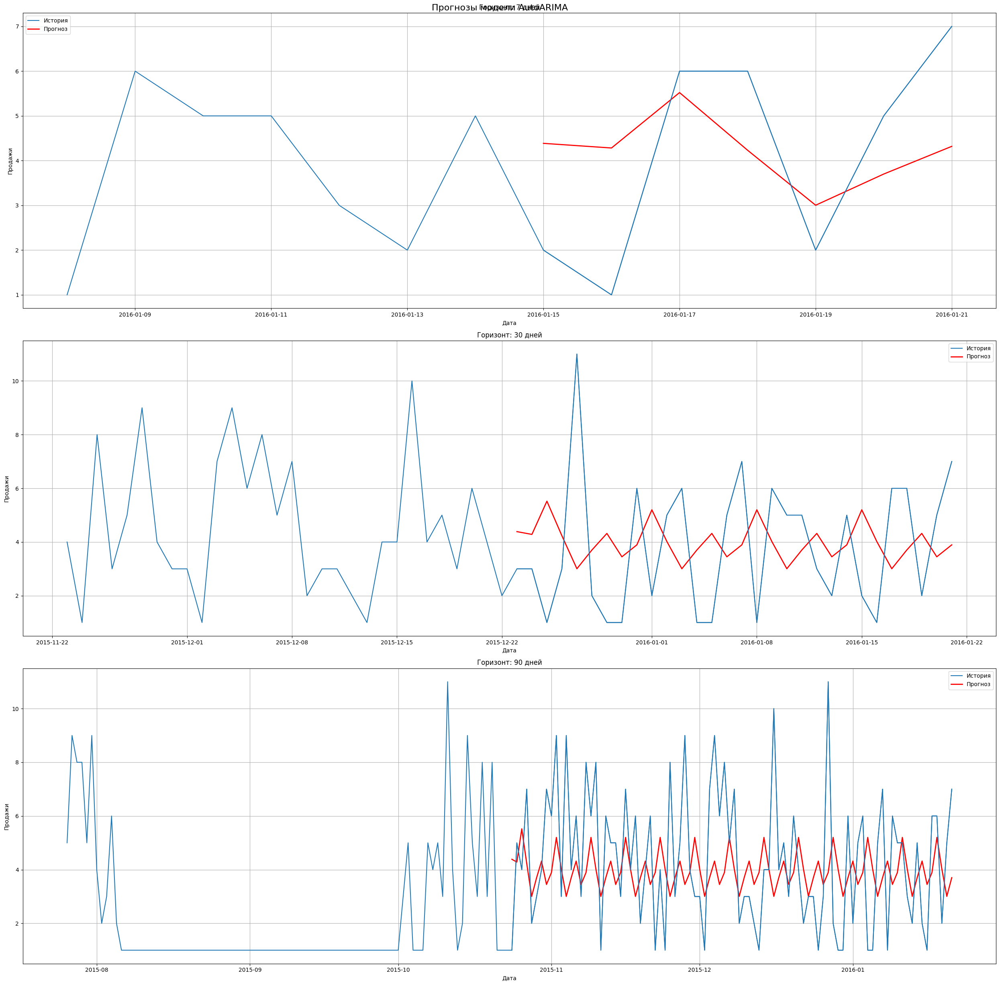

Model STL+ARIMA for horizon 7
Model STL+ARIMA for horizon 30
Model STL+ARIMA for horizon 90


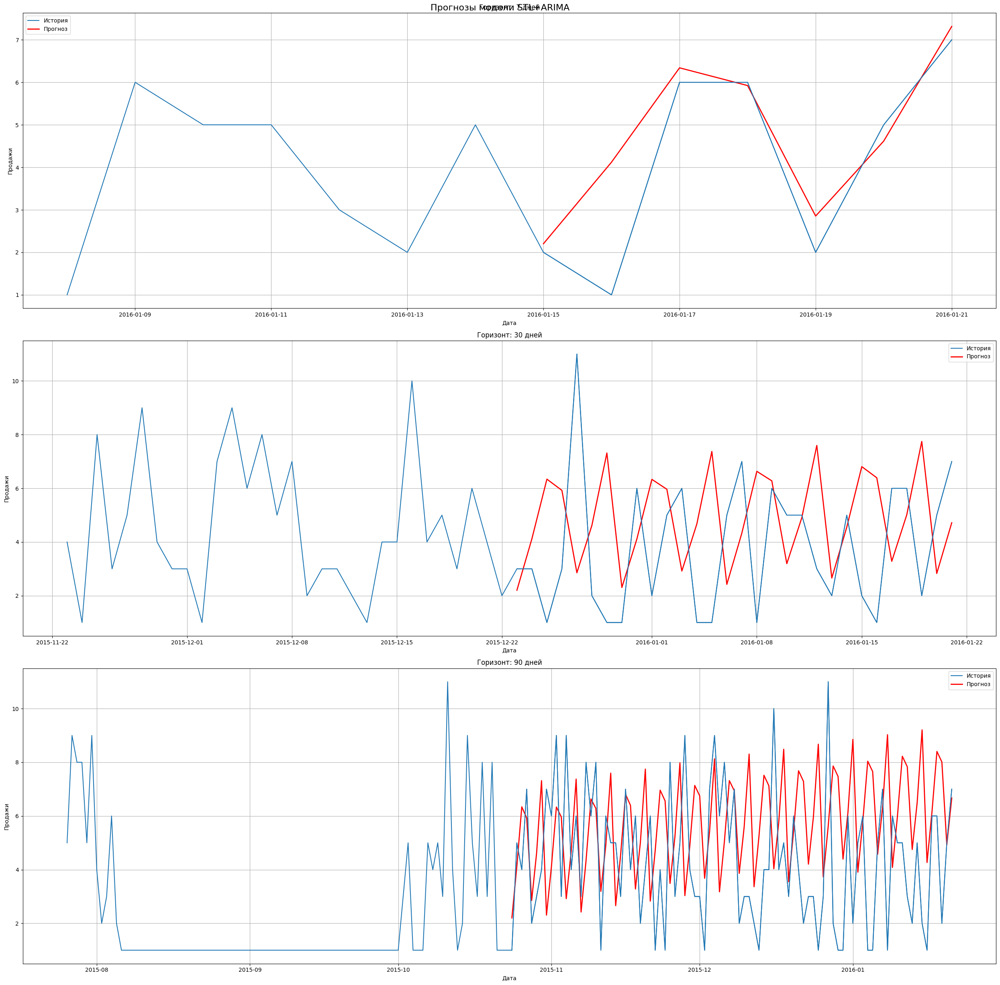

{('SARIMAX', 7): {'MAE': 2.8517053162566834, 'MAPE (%)': 64.34181736701129, 'RMSE': 3.330496531936365}, ('SARIMAX', 30): {'MAE': 2.209037795816693, 'MAPE (%)': 125.8508747457633, 'RMSE': 3.052896870319186}, ('SARIMAX', 90): {'MAE': 2.243285013349585, 'MAPE (%)': 93.77439893374692, 'RMSE': 2.6766575753107875}, ('AutoARIMA', 7): {'MAE': 1.8428754612501366, 'MAPE (%)': 85.64170172780089, 'RMSE': 2.0600994443972502}, ('AutoARIMA', 30): {'MAE': 2.523143560220538, 'MAPE (%)': 121.92226453403666, 'RMSE': 2.873598478952169}, ('AutoARIMA', 90): {'MAE': 2.0626158998767425, 'MAPE (%)': 75.33756213179491, 'RMSE': 2.563253244003128}, ('STL+ARIMA', 7): {'MAE': 0.7561134039850913, 'MAPE (%)': 54.86631361245931, 'RMSE': 1.2466905478074874}, ('STL+ARIMA', 30): {'MAE': 3.0580667690082373, 'MAPE (%)': 169.36390593798728, 'RMSE': 3.7179996910656596}, ('STL+ARIMA', 90): {'MAE': 2.8445437451344286, 'MAPE (%)': 127.3932546117164, 'RMSE': 3.48926893890466}}
Product  STORE_1_546
{'trend': {'exists': True, 'p_v

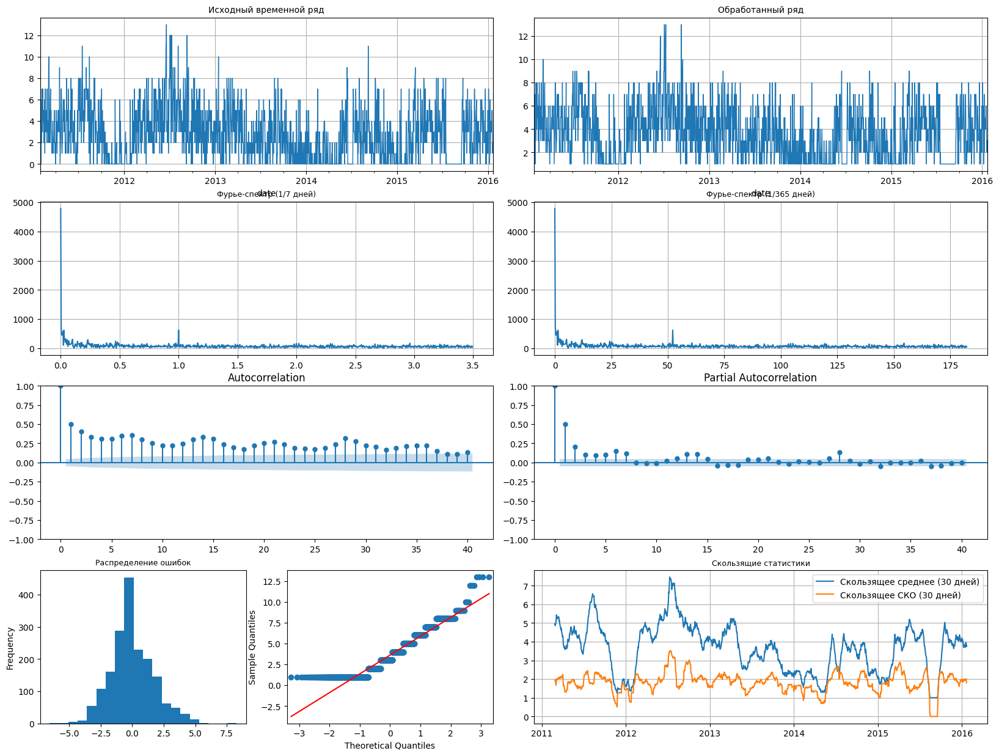

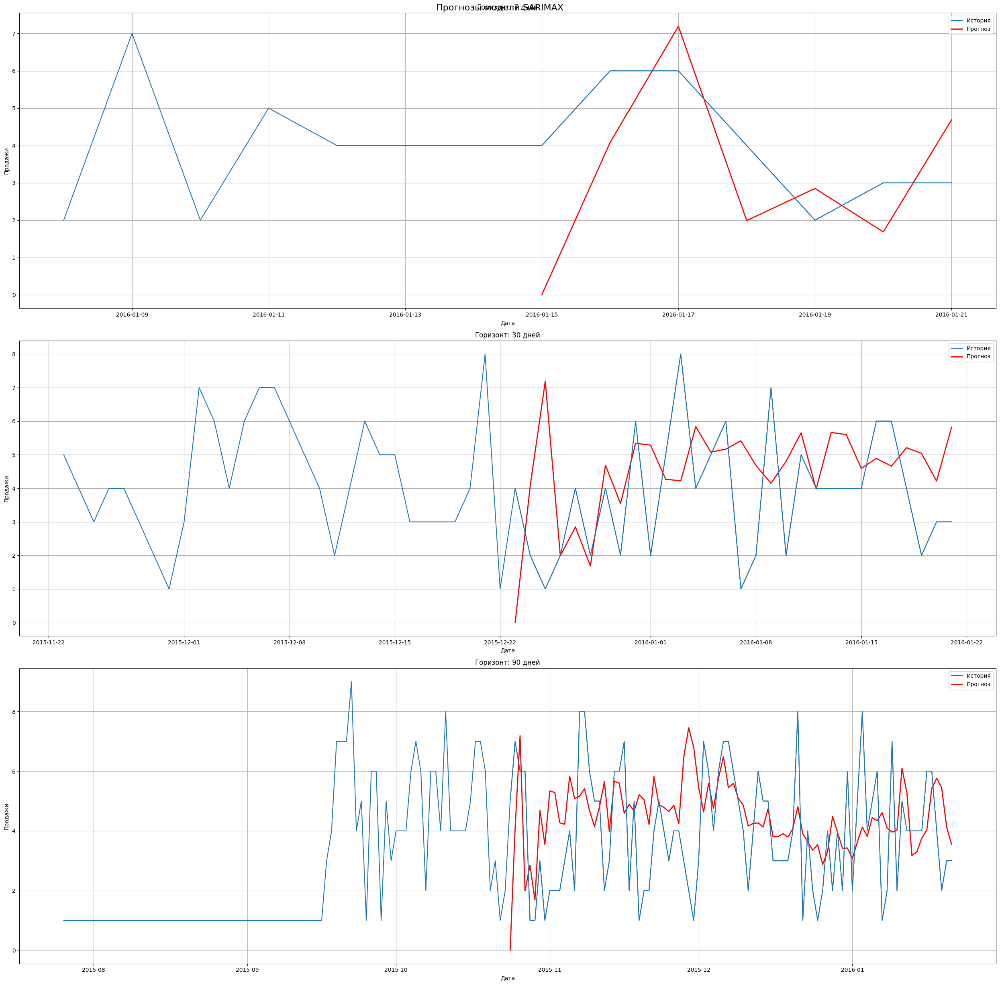

Model AutoARIMA for horizon 7

Best model:  ARIMA(2,0,0)(0,1,1)[7] intercept
Total fit time: 27.958 seconds
Model AutoARIMA for horizon 30

Best model:  ARIMA(2,0,0)(0,1,1)[7] intercept
Total fit time: 28.526 seconds
Model AutoARIMA for horizon 90

Best model:  ARIMA(2,0,0)(0,1,1)[7] intercept
Total fit time: 29.081 seconds


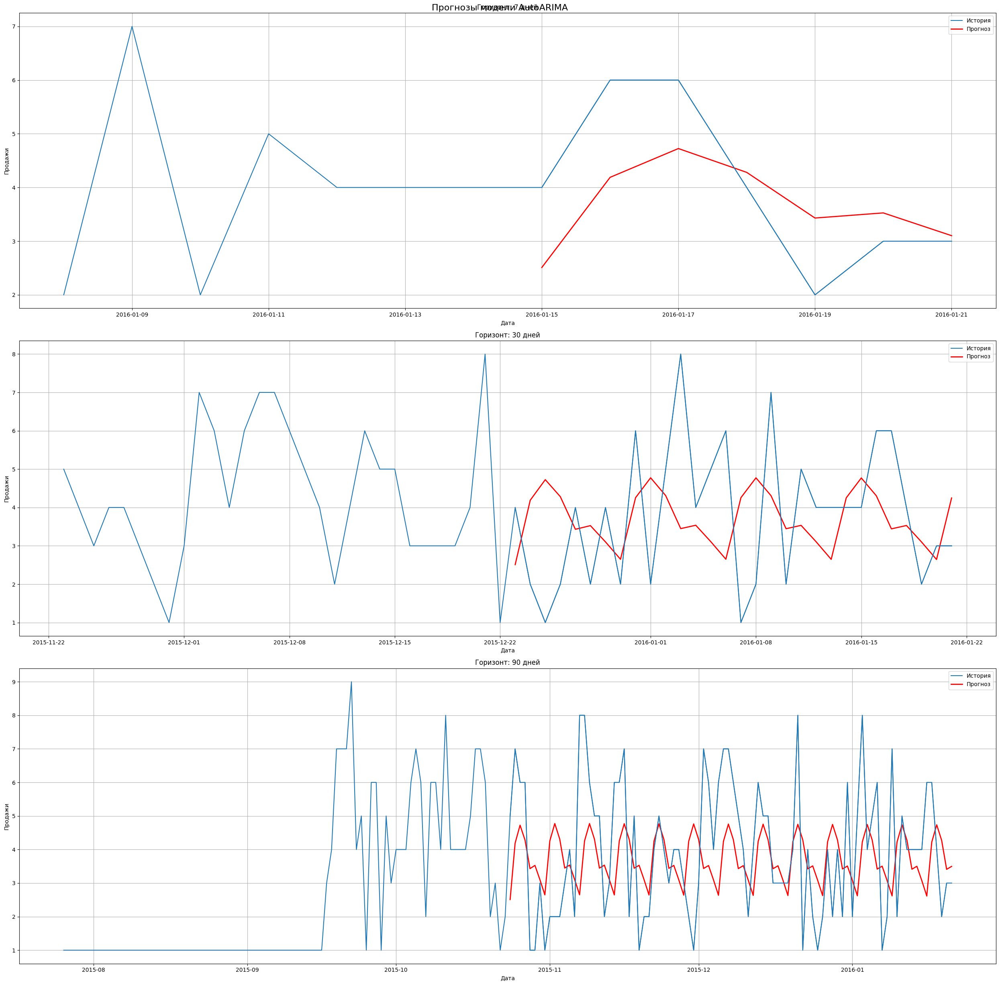

Model STL+ARIMA for horizon 7
Model STL+ARIMA for horizon 30
Model STL+ARIMA for horizon 90


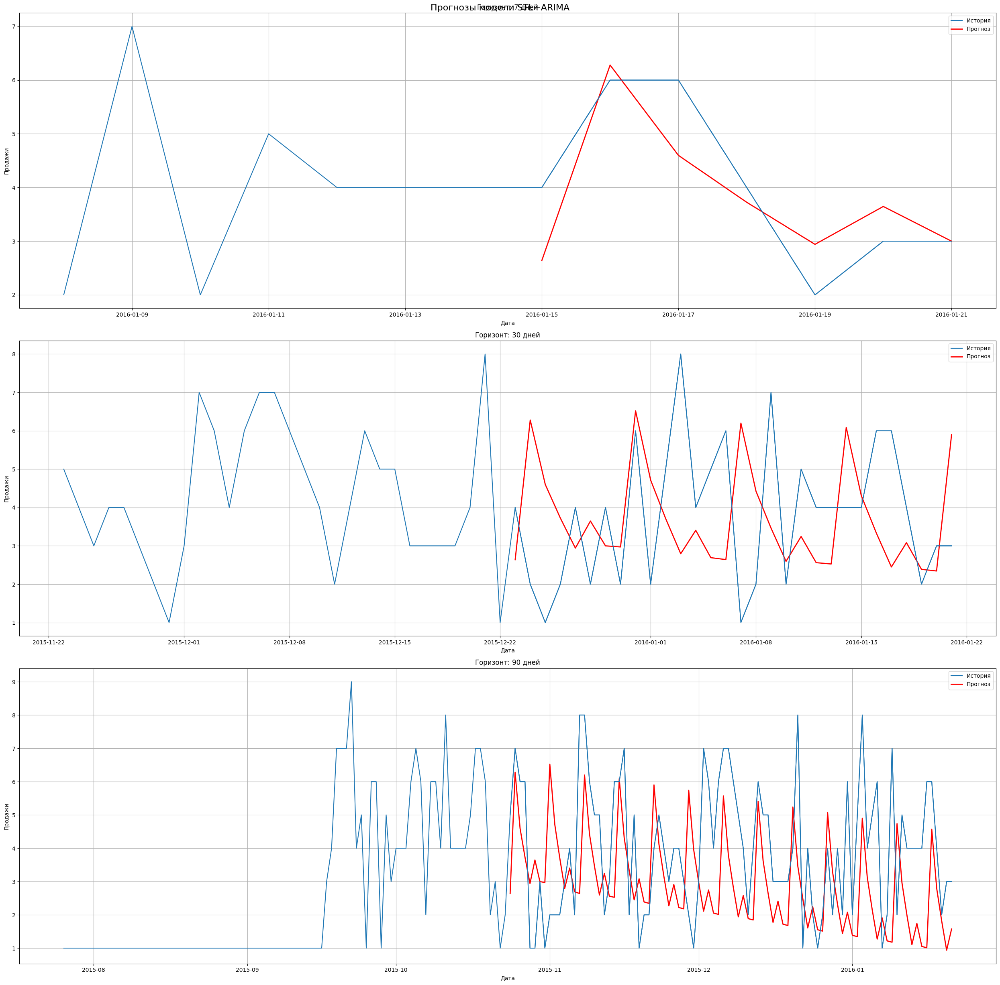

{('SARIMAX', 7): {'MAE': 1.8529098740208005, 'MAPE (%)': 49.22859462272541, 'RMSE': 2.085205561624156}, ('SARIMAX', 30): {'MAE': 1.8399837900227785, 'MAPE (%)': 82.83567925505652, 'RMSE': 2.3450512678272424}, ('SARIMAX', 90): {'MAE': 1.702400613349482, 'MAPE (%)': 71.61944511800903, 'RMSE': 2.1443897243218037}, ('AutoARIMA', 7): {'MAE': 0.9883319063488132, 'MAPE (%)': 26.894140599832077, 'RMSE': 1.167540628155707}, ('AutoARIMA', 30): {'MAE': 1.7041075598499764, 'MAPE (%)': 66.65431265985725, 'RMSE': 2.0208266601830034}, ('AutoARIMA', 90): {'MAE': 1.5752519551063333, 'MAPE (%)': 57.83830638316629, 'RMSE': 1.9558070333367426}, ('STL+ARIMA', 7): {'MAE': 0.7007949839218895, 'MAPE (%)': 19.64848995153777, 'RMSE': 0.8679607894095968}, ('STL+ARIMA', 30): {'MAE': 2.051263843586173, 'MAPE (%)': 79.41949160109976, 'RMSE': 2.4654804555523477}, ('STL+ARIMA', 90): {'MAE': 1.9132713371458079, 'MAPE (%)': 58.563777930365276, 'RMSE': 2.332532154708068}}
Product  STORE_1_547
{'trend': {'exists': True, 

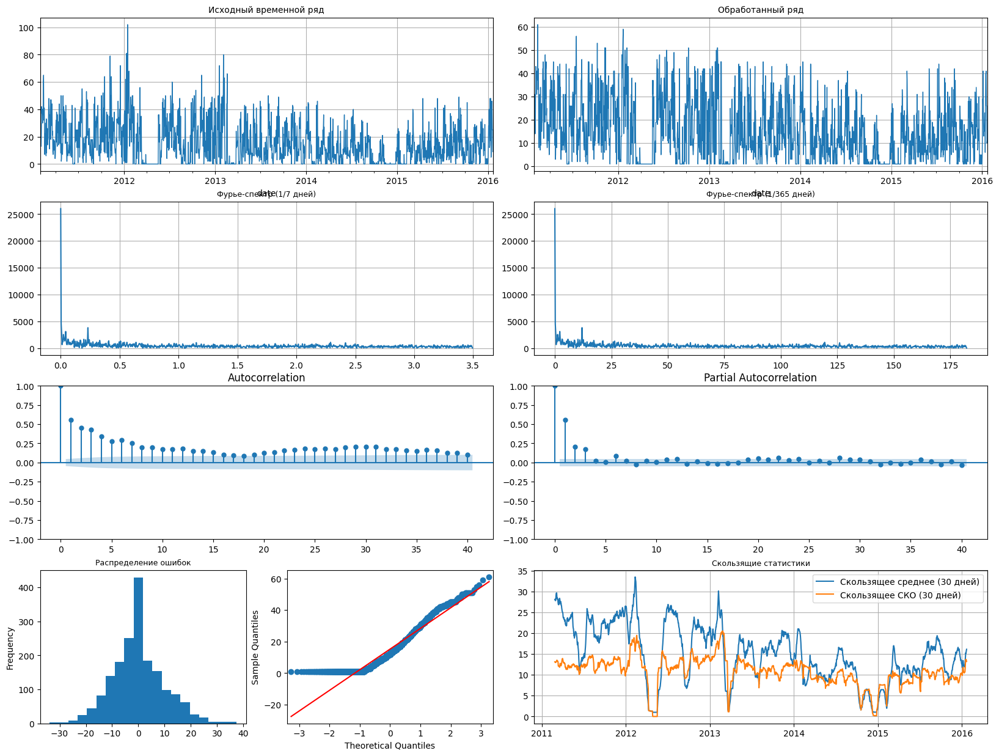

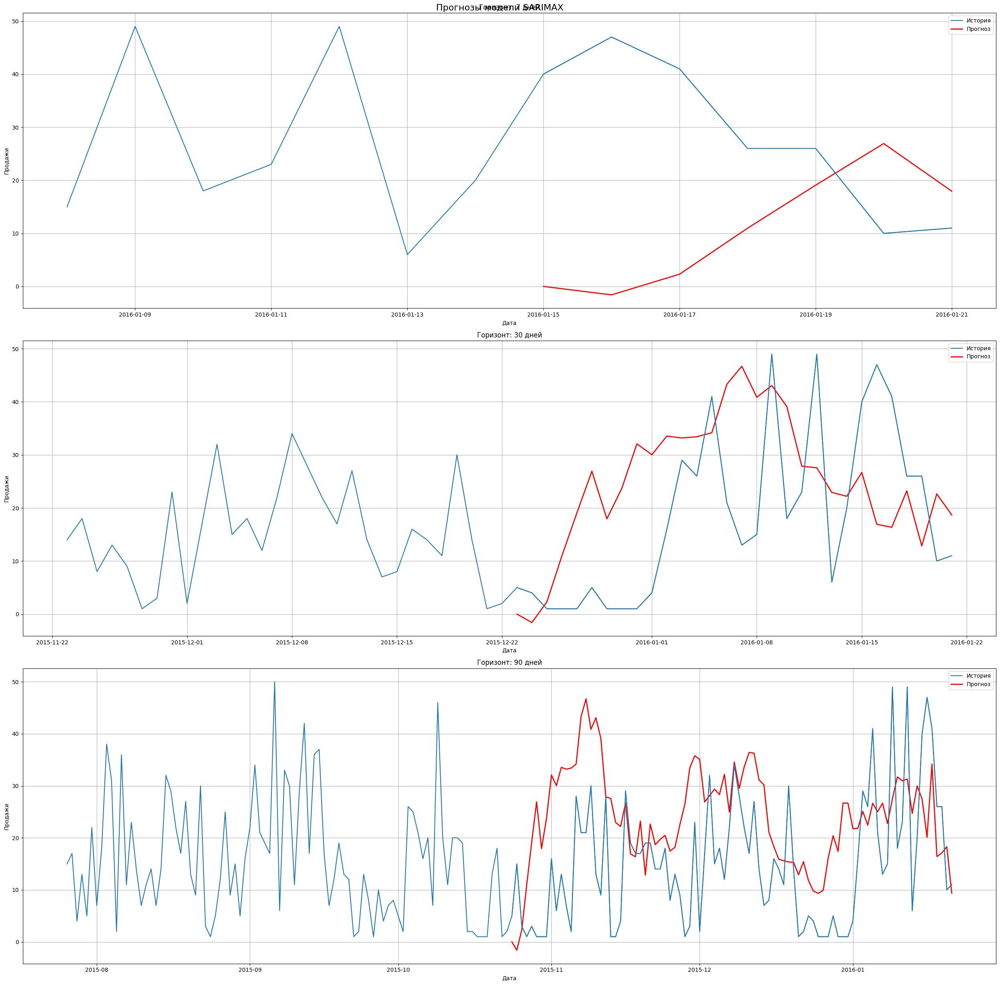

Model AutoARIMA for horizon 7

Best model:  ARIMA(3,0,0)(2,1,0)[7] intercept
Total fit time: 29.146 seconds
Model AutoARIMA for horizon 30

Best model:  ARIMA(3,0,0)(2,1,0)[7] intercept
Total fit time: 28.688 seconds
Model AutoARIMA for horizon 90

Best model:  ARIMA(3,0,0)(2,1,0)[7] intercept
Total fit time: 29.359 seconds


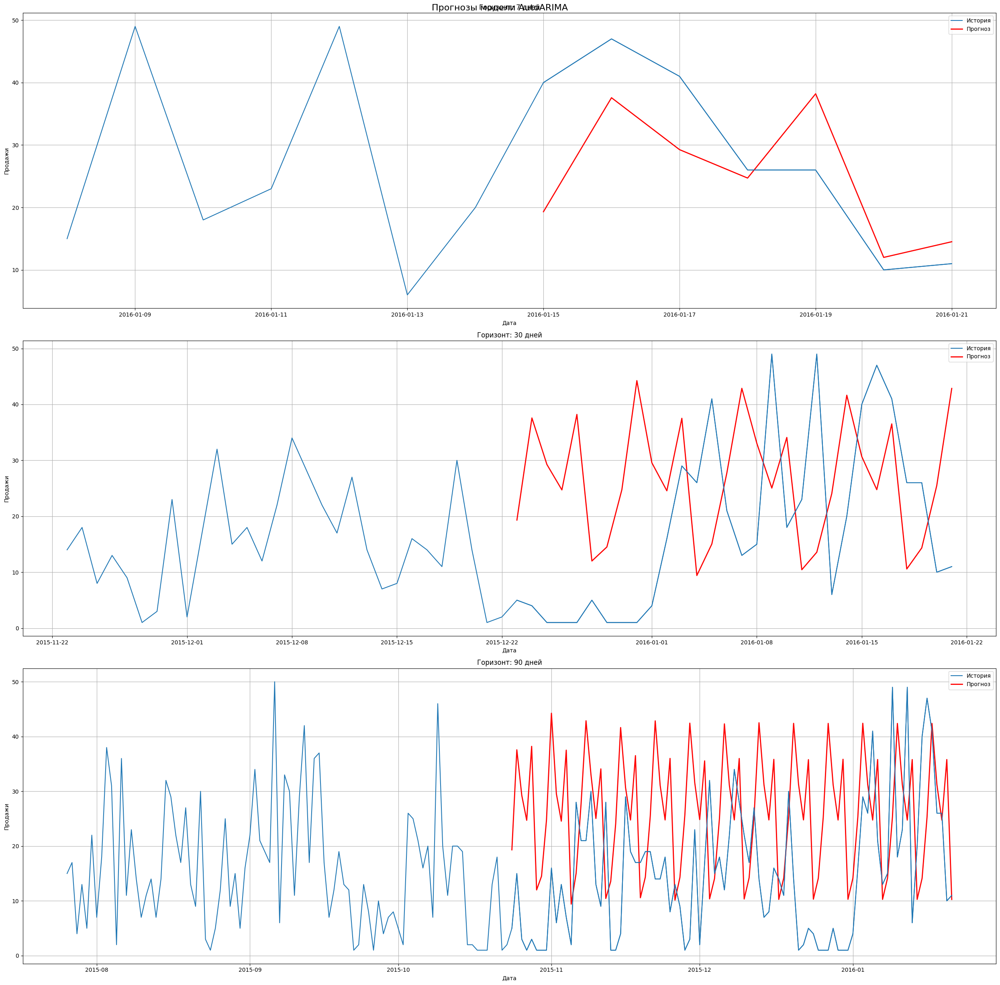

Model STL+ARIMA for horizon 7
Model STL+ARIMA for horizon 30
Model STL+ARIMA for horizon 90


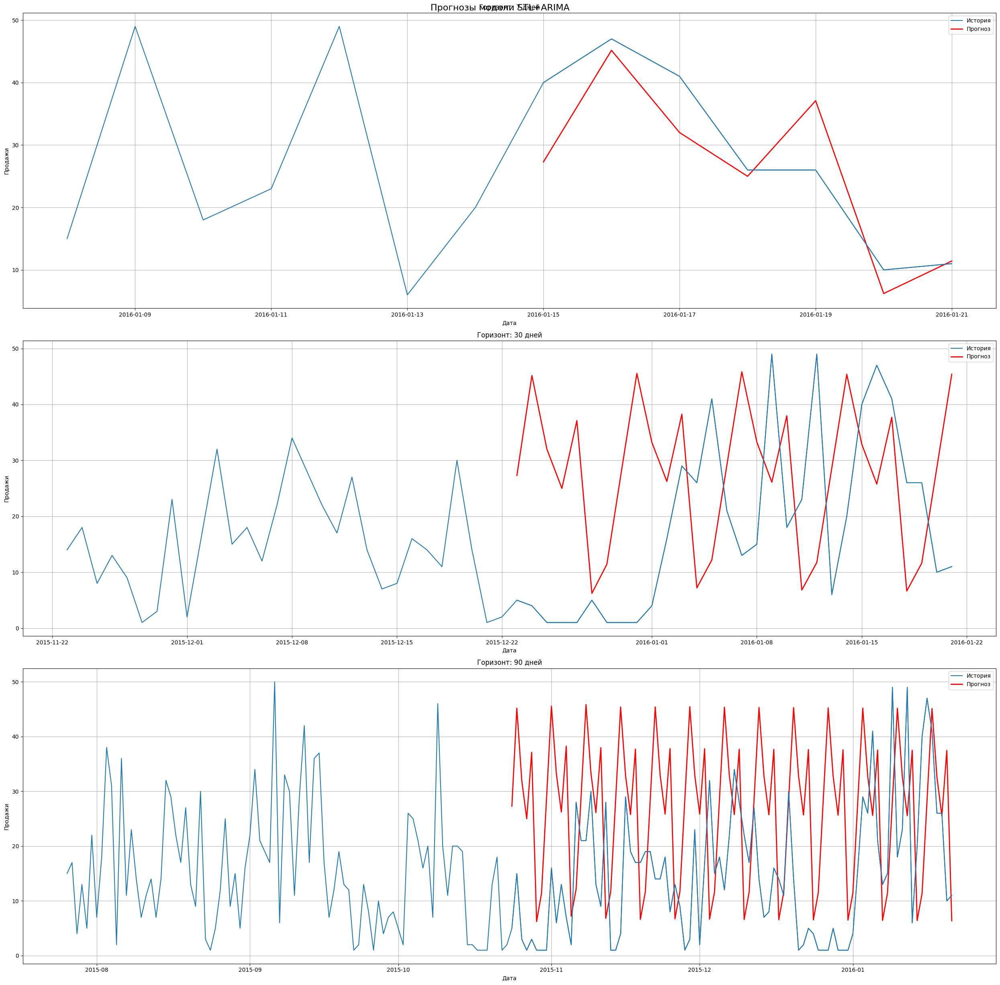

{('SARIMAX', 7): {'MAE': 24.729725042468186, 'MAPE (%)': 87.79362997486747, 'RMSE': 29.44040812418687}, ('SARIMAX', 30): {'MAE': 15.107378373743897, 'MAPE (%)': 431.5926966628085, 'RMSE': 17.77985748650494}, ('SARIMAX', 90): {'MAE': 12.875297692409873, 'MAPE (%)': 424.85335604756233, 'RMSE': 15.560169143538156}, ('AutoARIMA', 7): {'MAE': 8.694258816843035, 'MAPE (%)': 29.17885915726663, 'RMSE': 10.833114961001701}, ('AutoARIMA', 30): {'MAE': 20.087839235786824, 'MAPE (%)': 692.3581514002162, 'RMSE': 22.379929455953658}, ('AutoARIMA', 90): {'MAE': 16.235008276381418, 'MAPE (%)': 510.6739262236502, 'RMSE': 19.370179957897022}, ('STL+ARIMA', 7): {'MAE': 5.693349742516077, 'MAPE (%)': 20.834690722633102, 'RMSE': 7.41147700670329}, ('STL+ARIMA', 30): {'MAE': 21.883931340967862, 'MAPE (%)': 725.0083825867308, 'RMSE': 24.45623953261155}, ('STL+ARIMA', 90): {'MAE': 17.71297773088176, 'MAPE (%)': 527.8977187078548, 'RMSE': 20.971280995360807}}
Product  STORE_1_555
{'trend': {'exists': True, 'p_

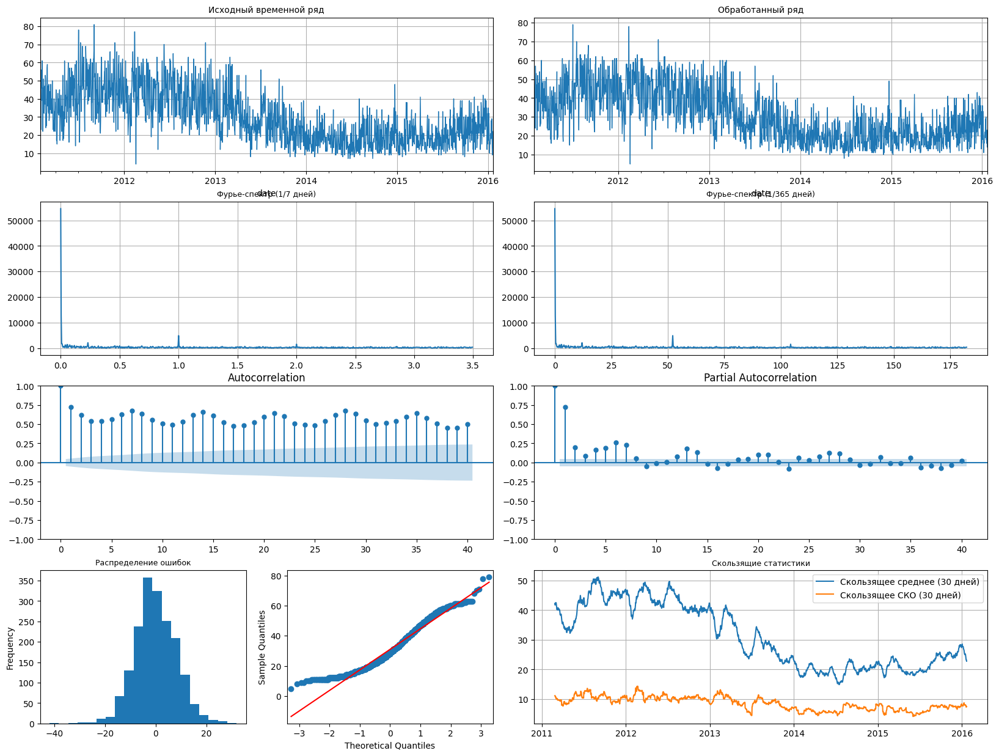

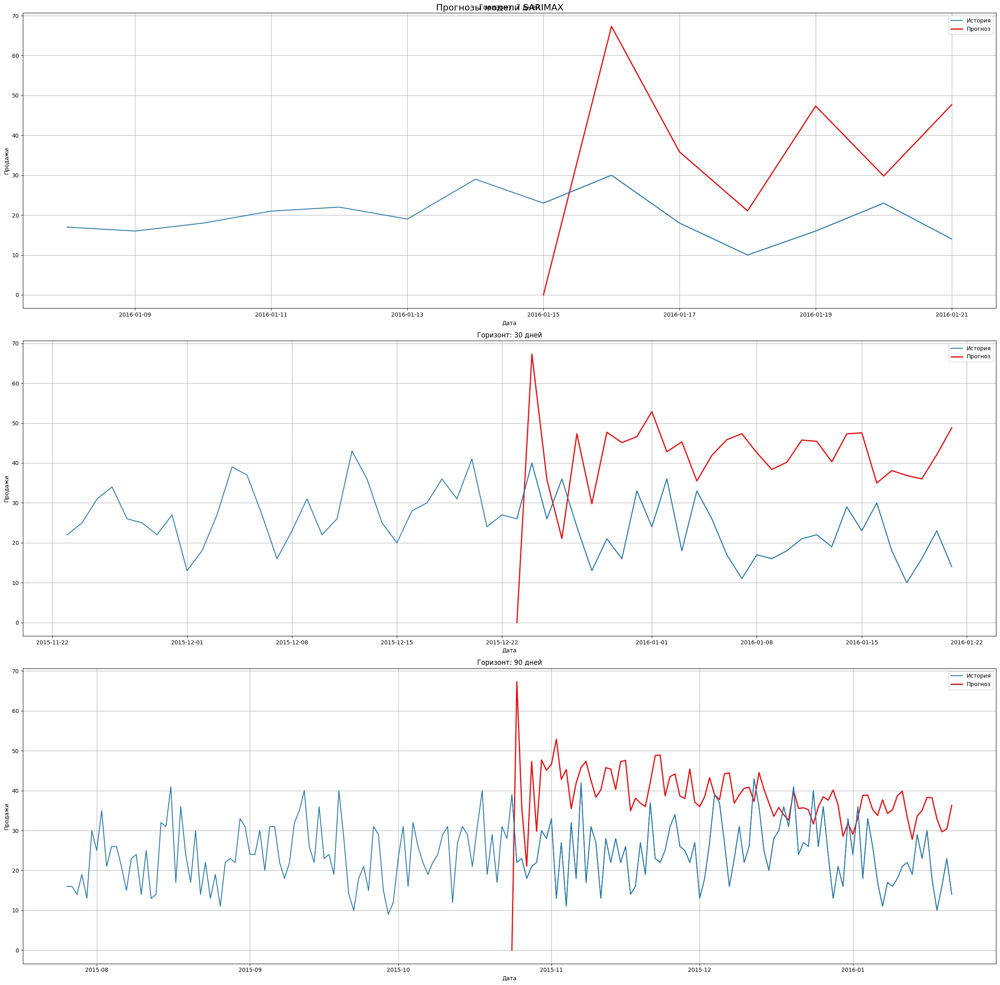

Model AutoARIMA for horizon 7

Best model:  ARIMA(3,0,0)(0,1,1)[7] intercept
Total fit time: 28.410 seconds
Model AutoARIMA for horizon 30

Best model:  ARIMA(3,0,0)(0,1,1)[7] intercept
Total fit time: 28.229 seconds
Model AutoARIMA for horizon 90

Best model:  ARIMA(3,0,0)(0,1,1)[7] intercept
Total fit time: 28.905 seconds


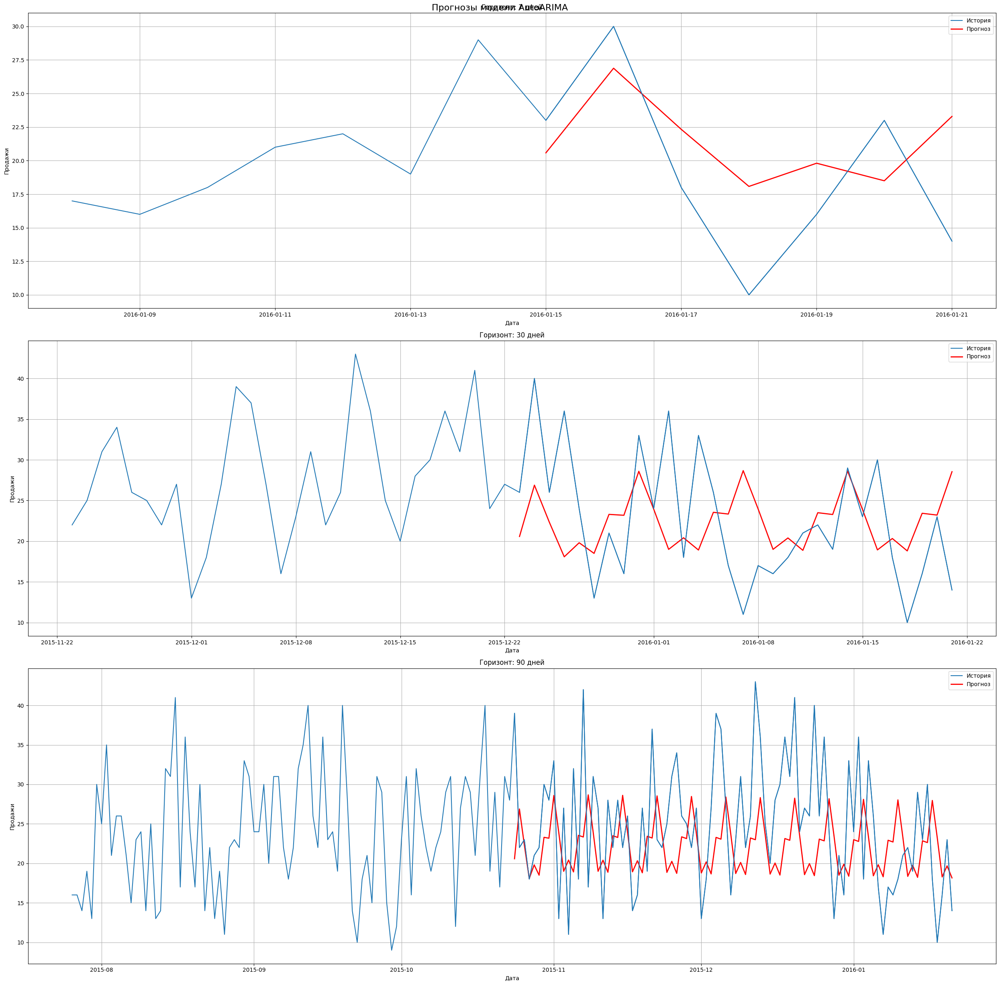

Model STL+ARIMA for horizon 7
Model STL+ARIMA for horizon 30
Model STL+ARIMA for horizon 90


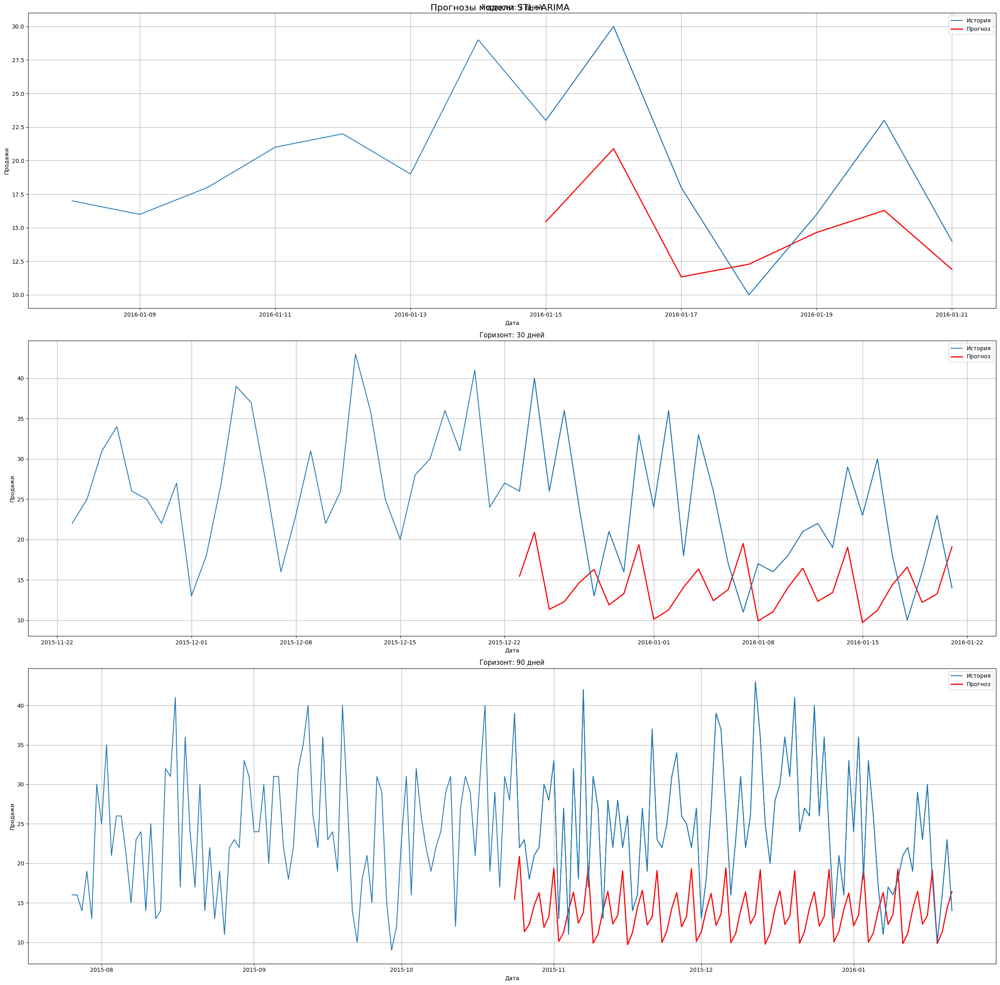

{('SARIMAX', 7): {'MAE': 23.006484541177482, 'MAPE (%)': 128.59982498422025, 'RMSE': 25.426410216889778}, ('SARIMAX', 30): {'MAE': 21.419881244100694, 'MAPE (%)': 115.26250172543327, 'RMSE': 22.86293967732525}, ('SARIMAX', 90): {'MAE': 14.972473208363049, 'MAPE (%)': 76.4685349581956, 'RMSE': 17.607555736054636}, ('AutoARIMA', 7): {'MAE': 5.078452844165691, 'MAPE (%)': 33.64612592183065, 'RMSE': 5.615669624783947}, ('AutoARIMA', 30): {'MAE': 6.322572317701042, 'MAPE (%)': 32.14342978240253, 'RMSE': 8.31383546193954}, ('AutoARIMA', 90): {'MAE': 7.093556921928097, 'MAPE (%)': 29.665633346701657, 'RMSE': 8.597908250781204}, ('STL+ARIMA', 7): {'MAE': 5.109398323210158, 'MAPE (%)': 25.095304266847673, 'RMSE': 5.864827146489071}, ('STL+ARIMA', 30): {'MAE': 9.90863246564562, 'MAPE (%)': 41.88112168705886, 'RMSE': 11.61659686592392}, ('STL+ARIMA', 90): {'MAE': 11.367391047371028, 'MAPE (%)': 41.30129242312851, 'RMSE': 13.561575369512449}}
Product  STORE_1_584
{'trend': {'exists': True, 'p_valu

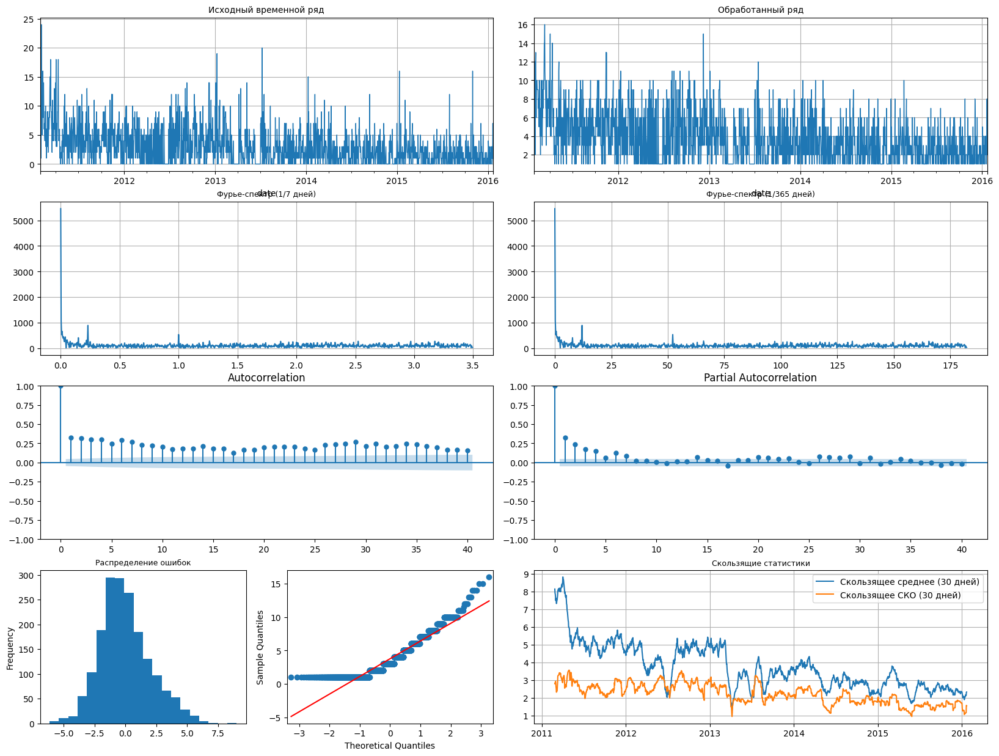

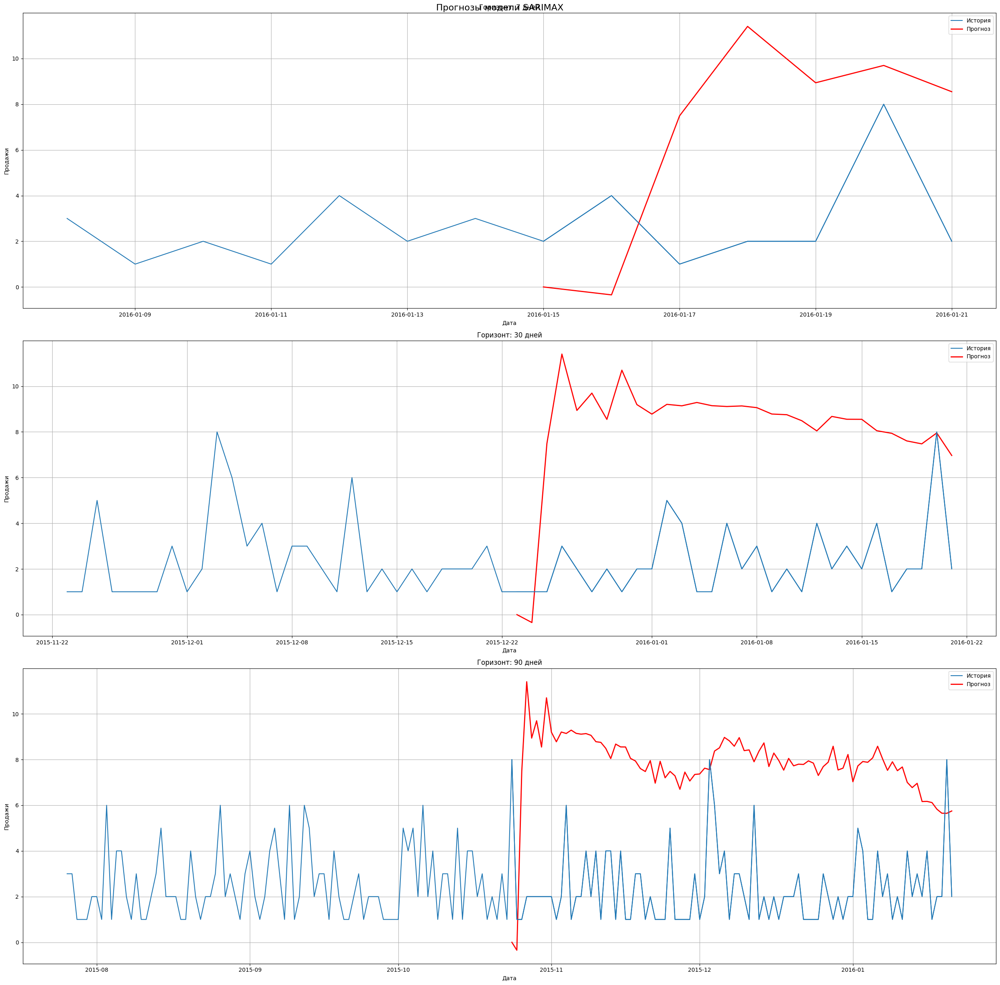

Model AutoARIMA for horizon 7

Best model:  ARIMA(1,0,2)(2,1,0)[7] intercept
Total fit time: 27.840 seconds
Model AutoARIMA for horizon 30

Best model:  ARIMA(1,0,2)(2,1,0)[7] intercept
Total fit time: 28.628 seconds
Model AutoARIMA for horizon 90

Best model:  ARIMA(1,0,2)(2,1,0)[7] intercept
Total fit time: 29.218 seconds


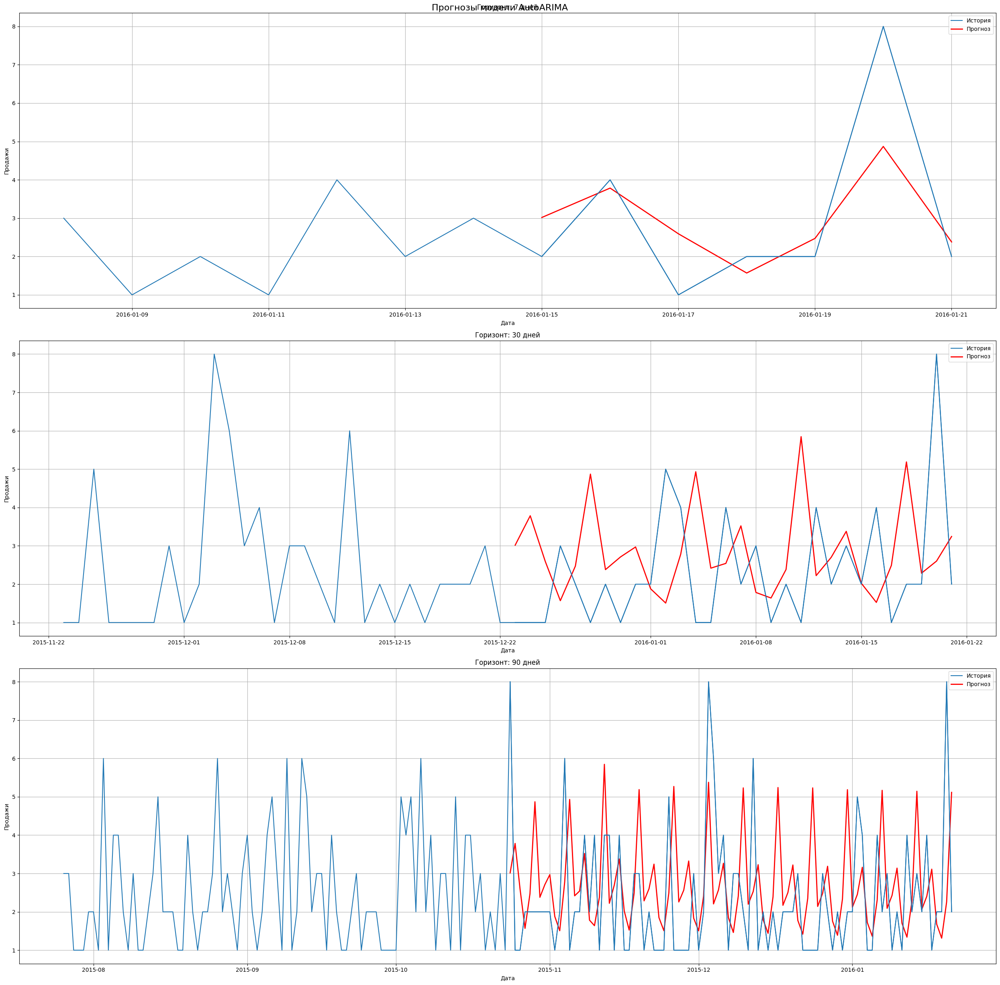

Model STL+ARIMA for horizon 7
Model STL+ARIMA for horizon 30
Model STL+ARIMA for horizon 90


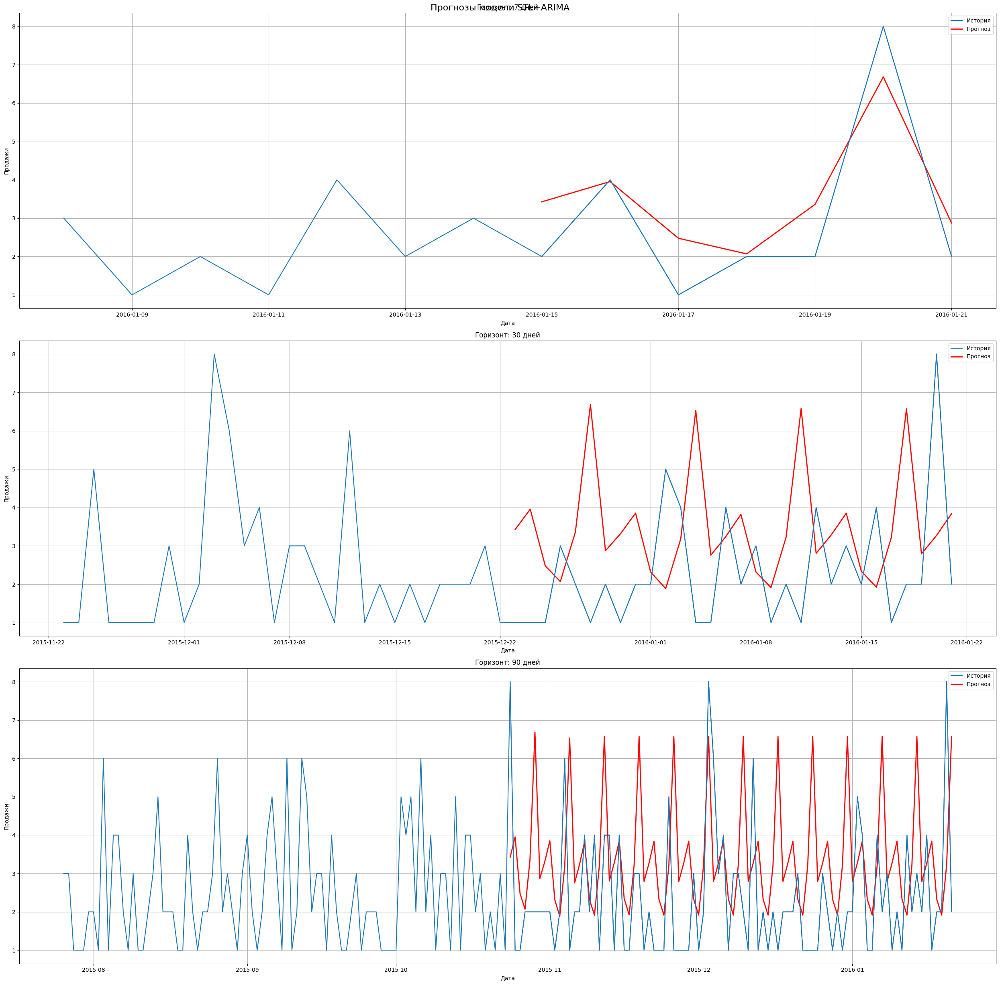

{('SARIMAX', 7): {'MAE': 5.347311383487553, 'MAPE (%)': 289.11057076448424, 'RMSE': 5.945597675823908}, ('SARIMAX', 30): {'MAE': 5.971232831968621, 'MAPE (%)': 377.6891336513978, 'RMSE': 6.363463008956819}, ('SARIMAX', 90): {'MAE': 5.689649886708561, 'MAPE (%)': 377.3074447109878, 'RMSE': 5.947012348844648}, ('AutoARIMA', 7): {'MAE': 1.0339920349055878, 'MAPE (%)': 45.53609481767144, 'RMSE': 1.4125950638795735}, ('AutoARIMA', 30): {'MAE': 1.7477624548043582, 'MAPE (%)': 110.20016046555601, 'RMSE': 2.234558617148242}, ('AutoARIMA', 90): {'MAE': 1.4996785179171745, 'MAPE (%)': 86.7131761180064, 'RMSE': 1.9422444178881992}, ('STL+ARIMA', 7): {'MAE': 0.9377832275477044, 'MAPE (%)': 50.21672720441871, 'RMSE': 1.1059078196367953}, ('STL+ARIMA', 30): {'MAE': 2.076204831044537, 'MAPE (%)': 140.79613593671223, 'RMSE': 2.6061001760048588}, ('STL+ARIMA', 90): {'MAE': 1.8134000561734063, 'MAPE (%)': 117.79983644810734, 'RMSE': 2.324929554316434}}
Product  STORE_1_586
{'trend': {'exists': True, 'p_

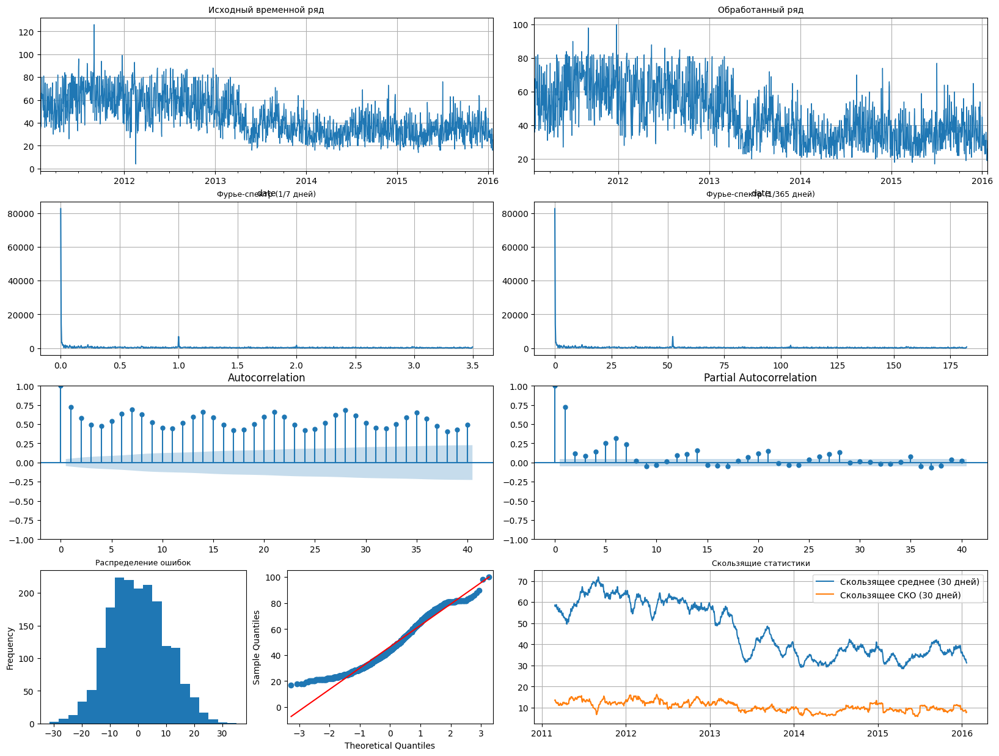

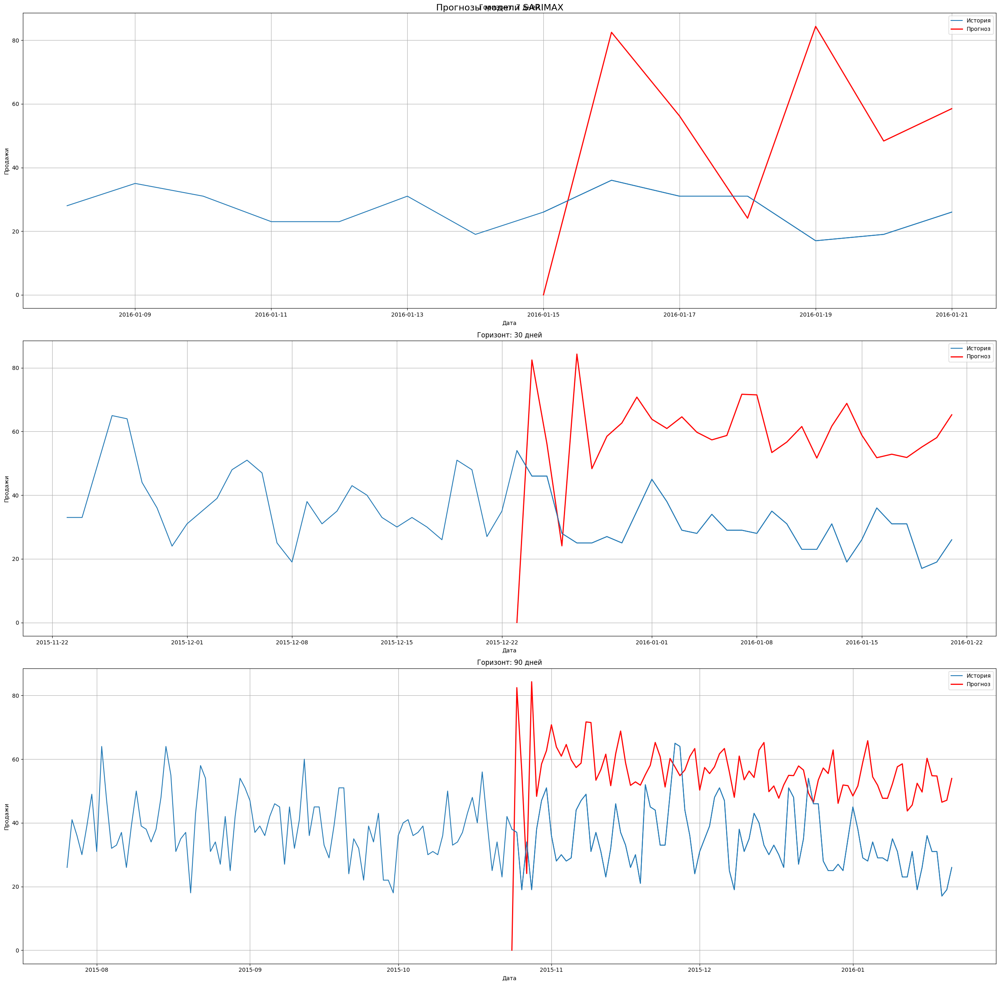

Model AutoARIMA for horizon 7

Best model:  ARIMA(4,0,0)(0,1,1)[7] intercept
Total fit time: 29.501 seconds
Model AutoARIMA for horizon 30

Best model:  ARIMA(4,0,0)(0,1,1)[7] intercept
Total fit time: 28.959 seconds
Model AutoARIMA for horizon 90

Best model:  ARIMA(4,0,0)(0,1,1)[7] intercept
Total fit time: 29.183 seconds


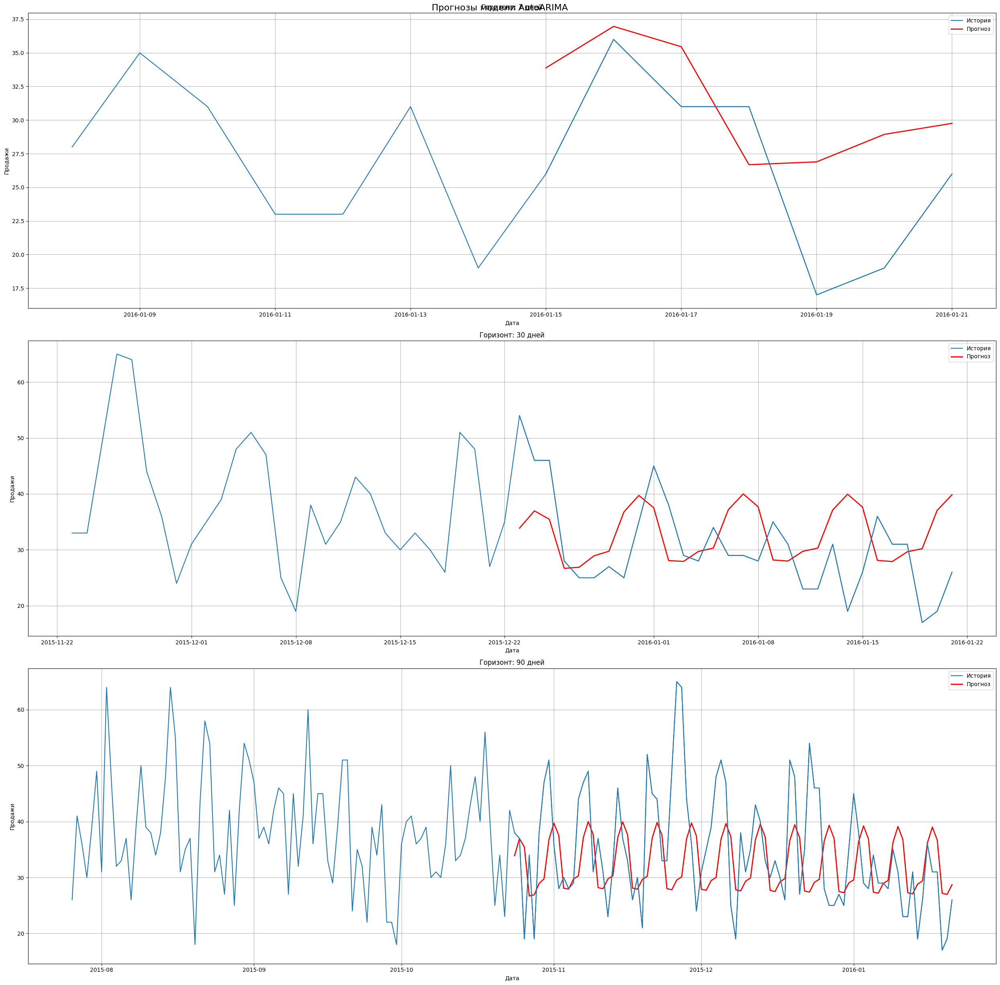

Model STL+ARIMA for horizon 7
Model STL+ARIMA for horizon 30
Model STL+ARIMA for horizon 90


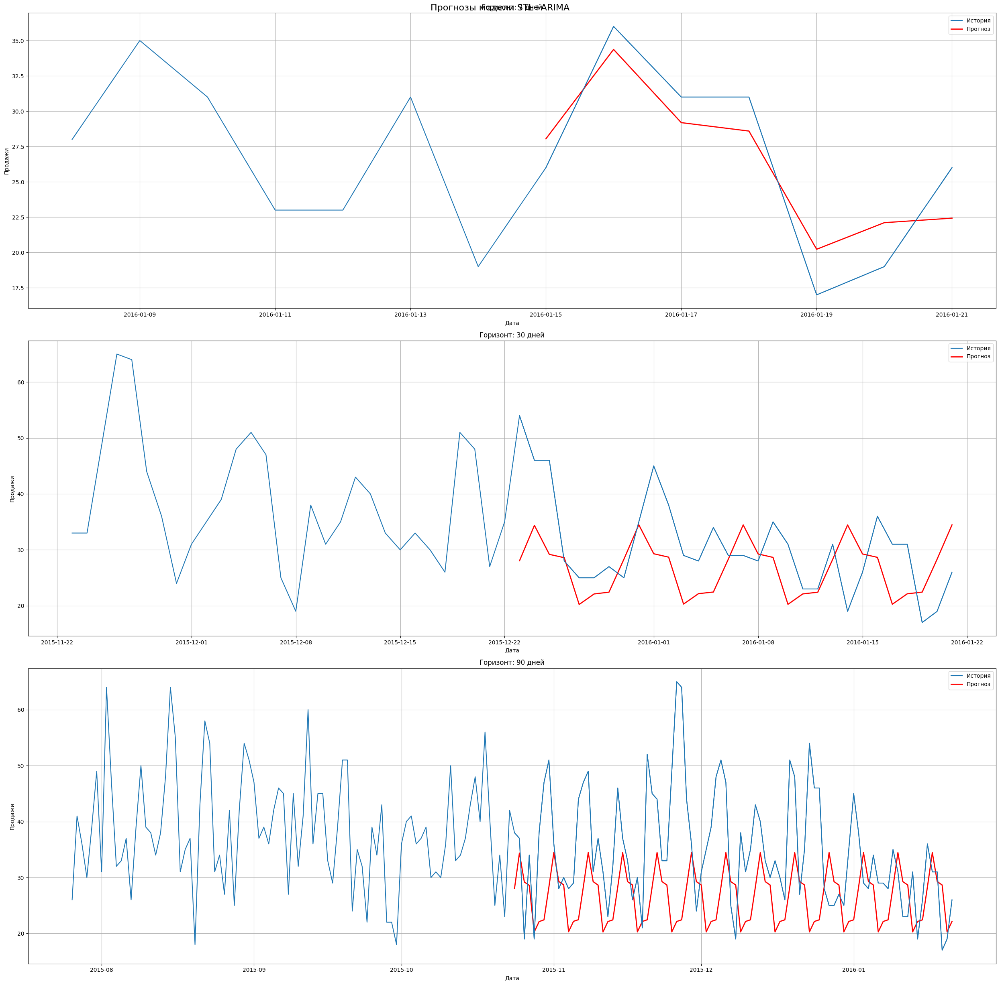

{('SARIMAX', 7): {'MAE': 33.38658198800884, 'MAPE (%)': 143.9947062052933, 'RMSE': 37.73093259107841}, ('SARIMAX', 30): {'MAE': 31.34536675914716, 'MAPE (%)': 113.53751537872418, 'RMSE': 33.62805601717804}, ('SARIMAX', 90): {'MAE': 22.55331543138084, 'MAPE (%)': 77.52666082187973, 'RMSE': 25.049141932538134}, ('AutoARIMA', 7): {'MAE': 5.886772122398122, 'MAPE (%)': 26.60601037538095, 'RMSE': 6.67923720087481}, ('AutoARIMA', 30): {'MAE': 7.962131179322431, 'MAPE (%)': 28.999624321460427, 'RMSE': 9.613110899131128}, ('AutoARIMA', 90): {'MAE': 8.10802216579303, 'MAPE (%)': 23.443567033067843, 'RMSE': 10.562329716044559}, ('STL+ARIMA', 7): {'MAE': 2.542928444110516, 'MAPE (%)': 10.726449326501024, 'RMSE': 2.6390235039130734}, ('STL+ARIMA', 30): {'MAE': 7.322374748352295, 'MAPE (%)': 23.435962677867764, 'RMSE': 9.331248594409168}, ('STL+ARIMA', 90): {'MAE': 10.284099793616695, 'MAPE (%)': 26.758241227438294, 'RMSE': 13.750395348661355}}
Product  STORE_1_587
{'trend': {'exists': True, 'p_val

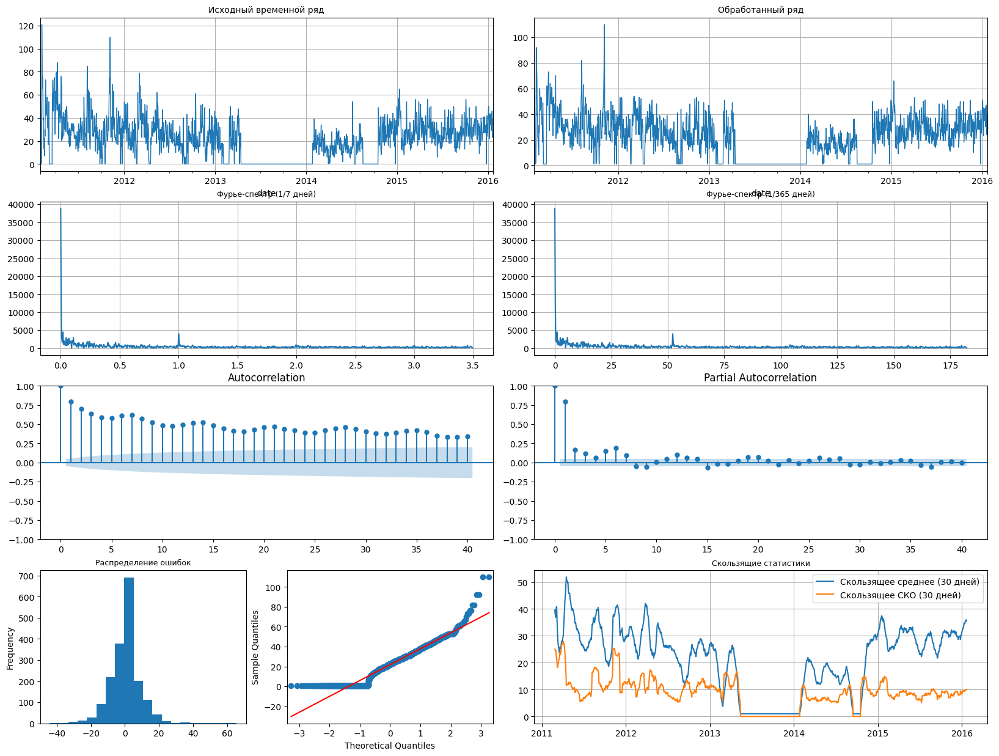

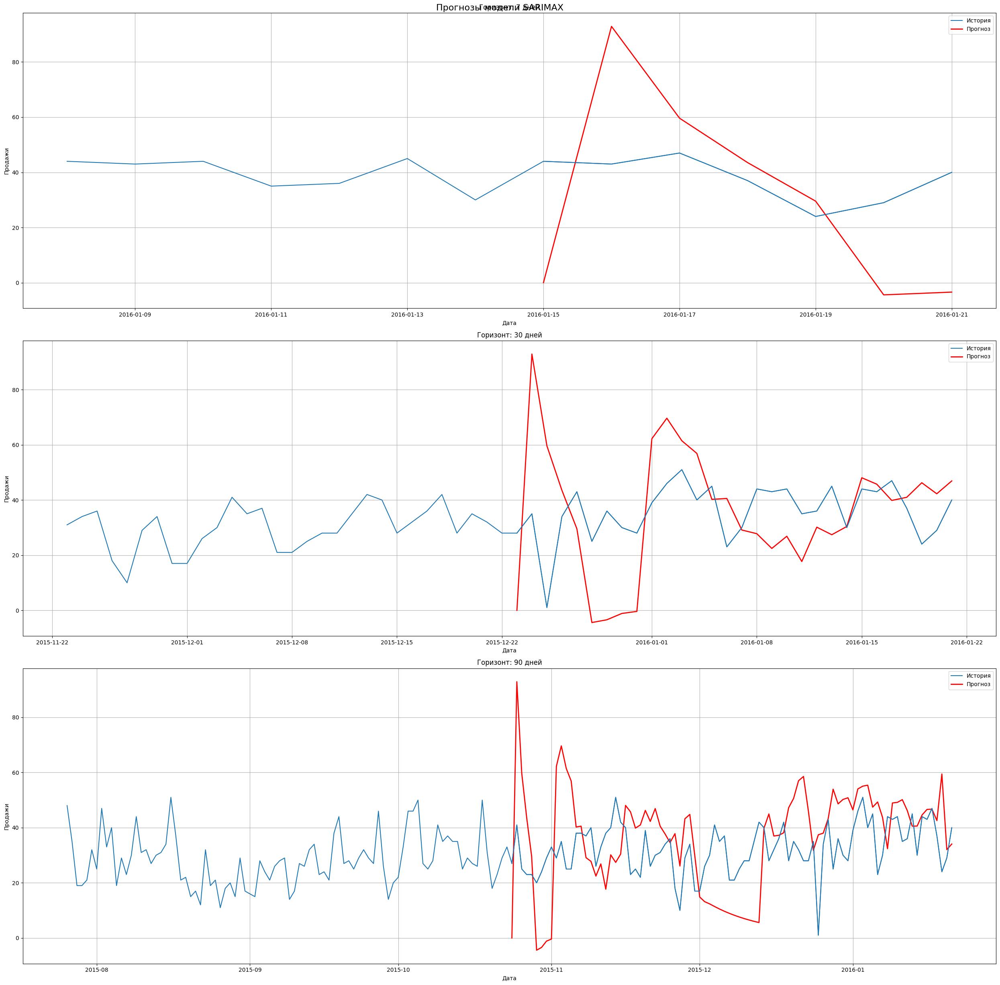

Model AutoARIMA for horizon 7

Best model:  ARIMA(1,0,1)(1,1,2)[7] intercept
Total fit time: 28.304 seconds
Model AutoARIMA for horizon 30

Best model:  ARIMA(1,0,1)(1,1,2)[7] intercept
Total fit time: 28.502 seconds
Model AutoARIMA for horizon 90

Best model:  ARIMA(1,0,1)(1,1,2)[7] intercept
Total fit time: 28.169 seconds


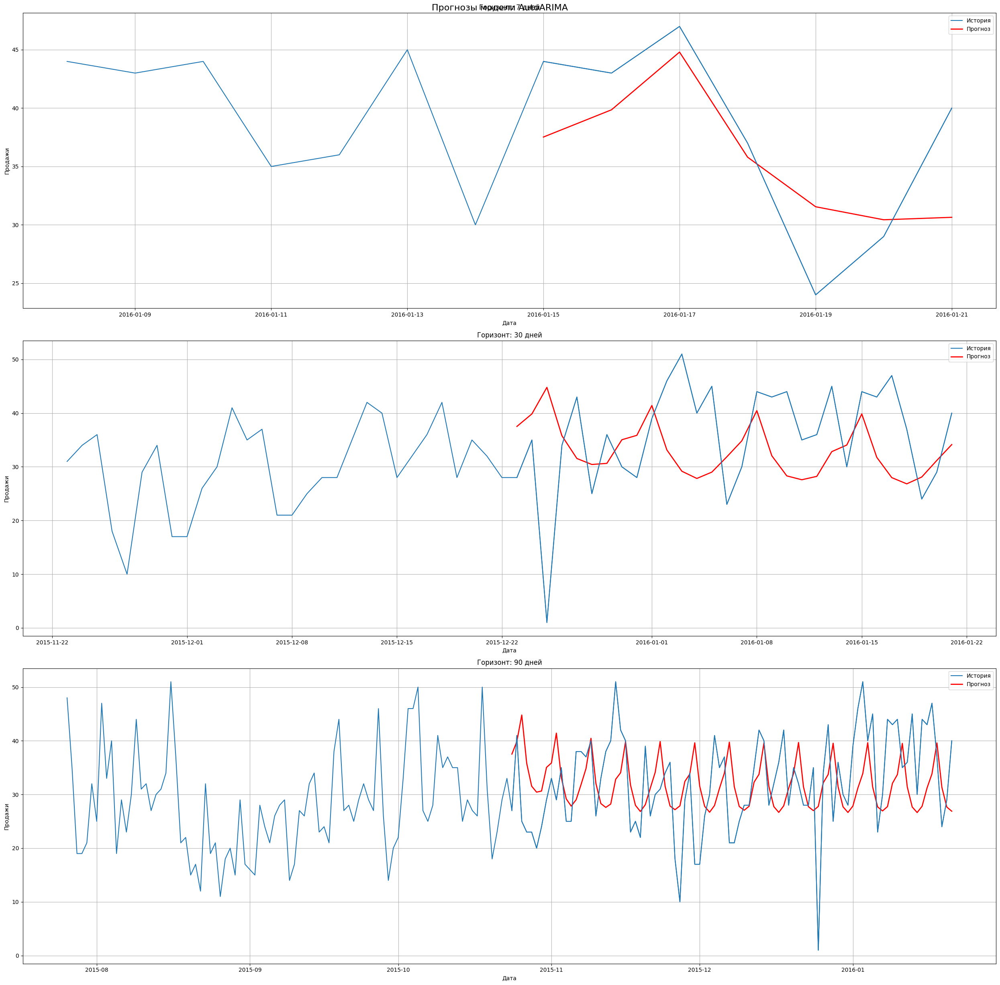

Model STL+ARIMA for horizon 7
Model STL+ARIMA for horizon 30
Model STL+ARIMA for horizon 90


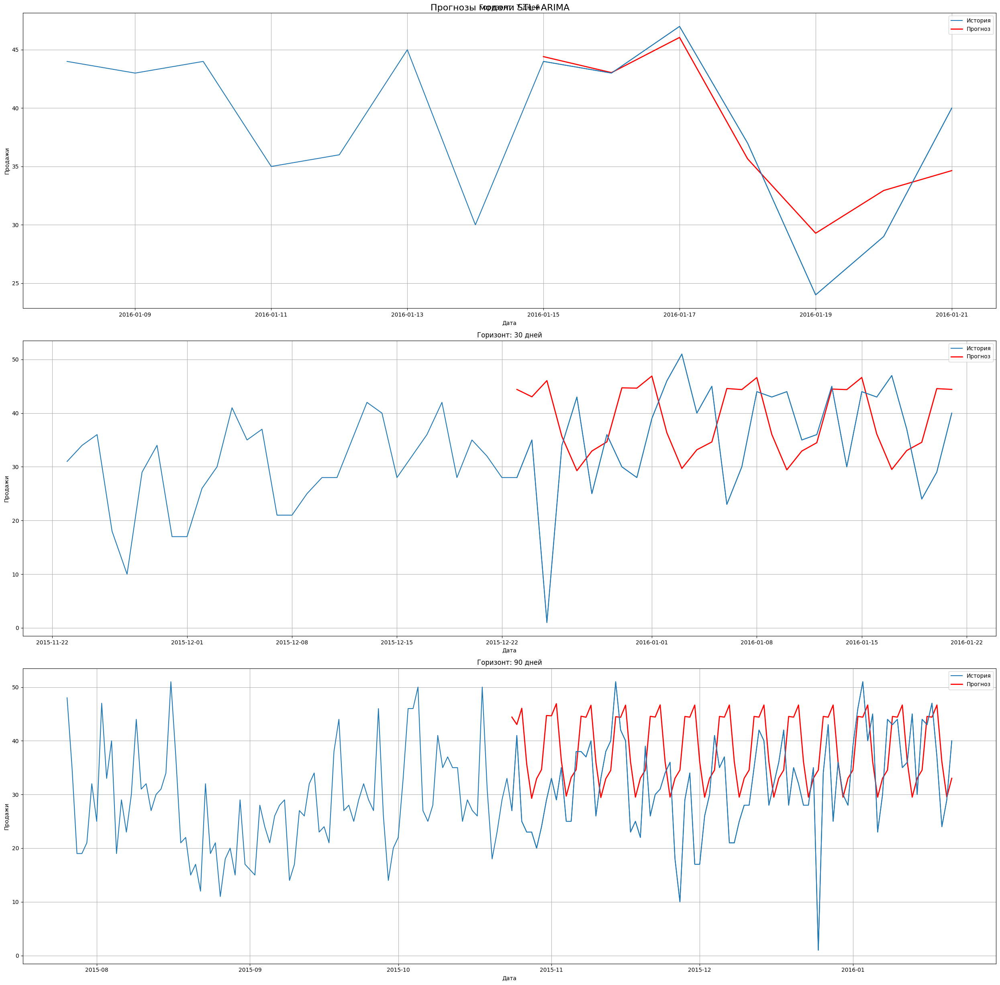

{('SARIMAX', 7): {'MAE': 27.919481538807247, 'MAPE (%)': 72.49301376015482, 'RMSE': 33.08088356924793}, ('SARIMAX', 30): {'MAE': 18.288644121404193, 'MAPE (%)': 243.67403615835607, 'RMSE': 23.30588028122737}, ('SARIMAX', 90): {'MAE': 15.651321837992883, 'MAPE (%)': 93.47530808377523, 'RMSE': 19.24396307965049}, ('AutoARIMA', 7): {'MAE': 4.480936187724156, 'MAPE (%)': 12.82329758976925, 'RMSE': 5.408139131107742}, ('AutoARIMA', 30): {'MAE': 9.745203440042546, 'MAPE (%)': 167.80020890125996, 'RMSE': 12.63288036807488}, ('AutoARIMA', 90): {'MAE': 7.595506938618267, 'MAPE (%)': 54.80193653133355, 'RMSE': 9.586477473392193}, ('STL+ARIMA', 7): {'MAE': 2.4745191046878188, 'MAPE (%)': 7.952248484846722, 'RMSE': 3.272995724744346}, ('STL+ARIMA', 30): {'MAE': 10.724288768098518, 'MAPE (%)': 177.52807277575798, 'RMSE': 13.881079432980451}, ('STL+ARIMA', 90): {'MAE': 8.712810753591103, 'MAPE (%)': 68.98660568465115, 'RMSE': 11.048487420519292}}
Product  STORE_1_714
{'trend': {'exists': True, 'p_va

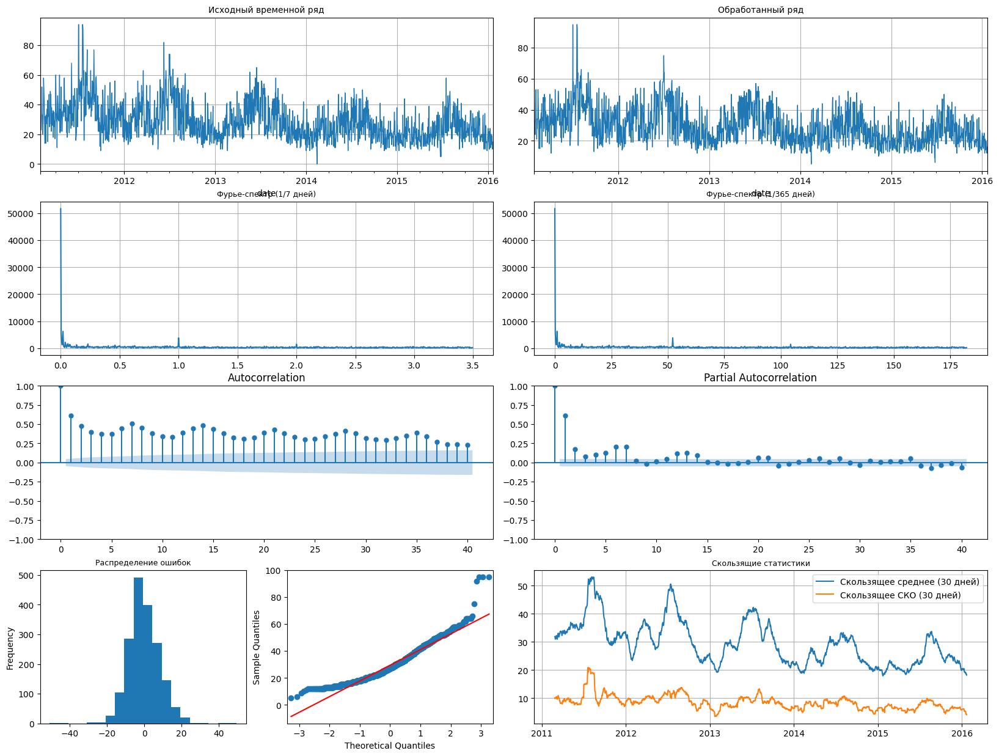

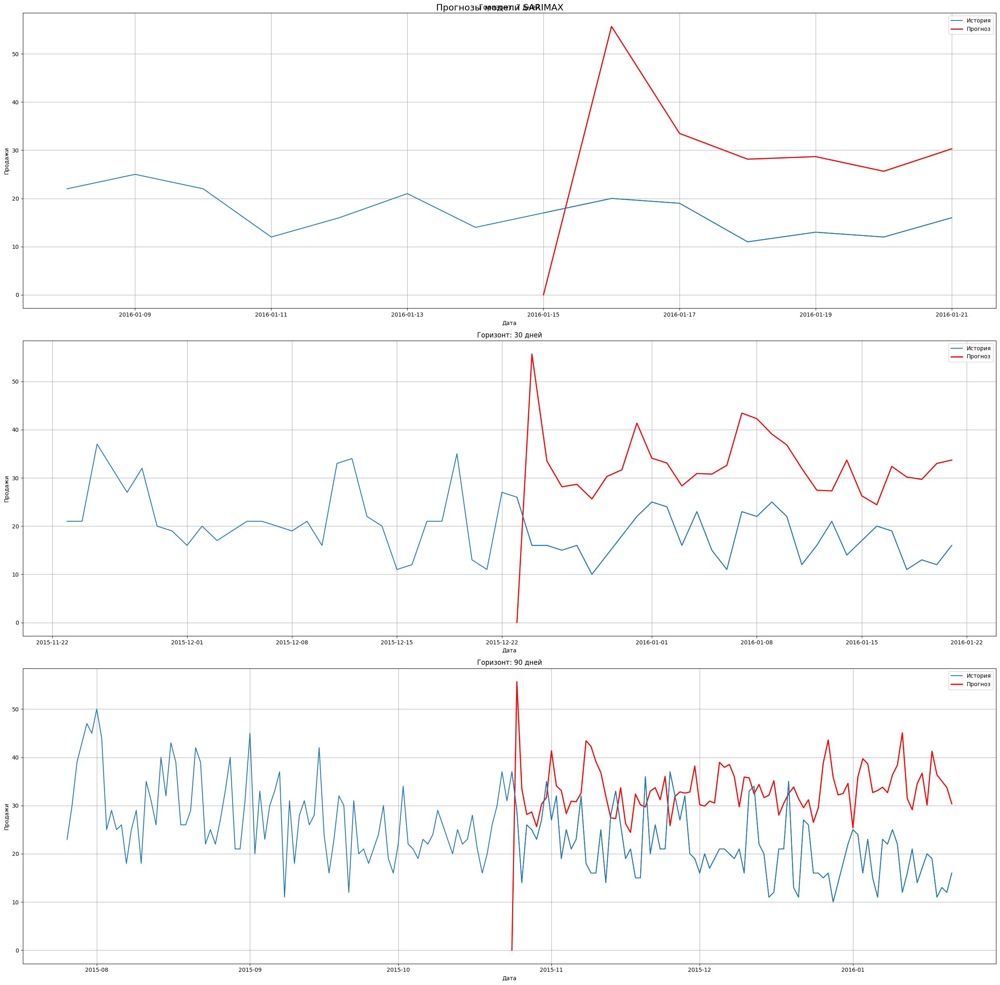

Model AutoARIMA for horizon 7

Best model:  ARIMA(0,0,4)(0,1,1)[7] intercept
Total fit time: 27.557 seconds
Model AutoARIMA for horizon 30

Best model:  ARIMA(0,0,4)(0,1,1)[7] intercept
Total fit time: 27.849 seconds
Model AutoARIMA for horizon 90

Best model:  ARIMA(0,0,4)(0,1,1)[7] intercept
Total fit time: 28.433 seconds


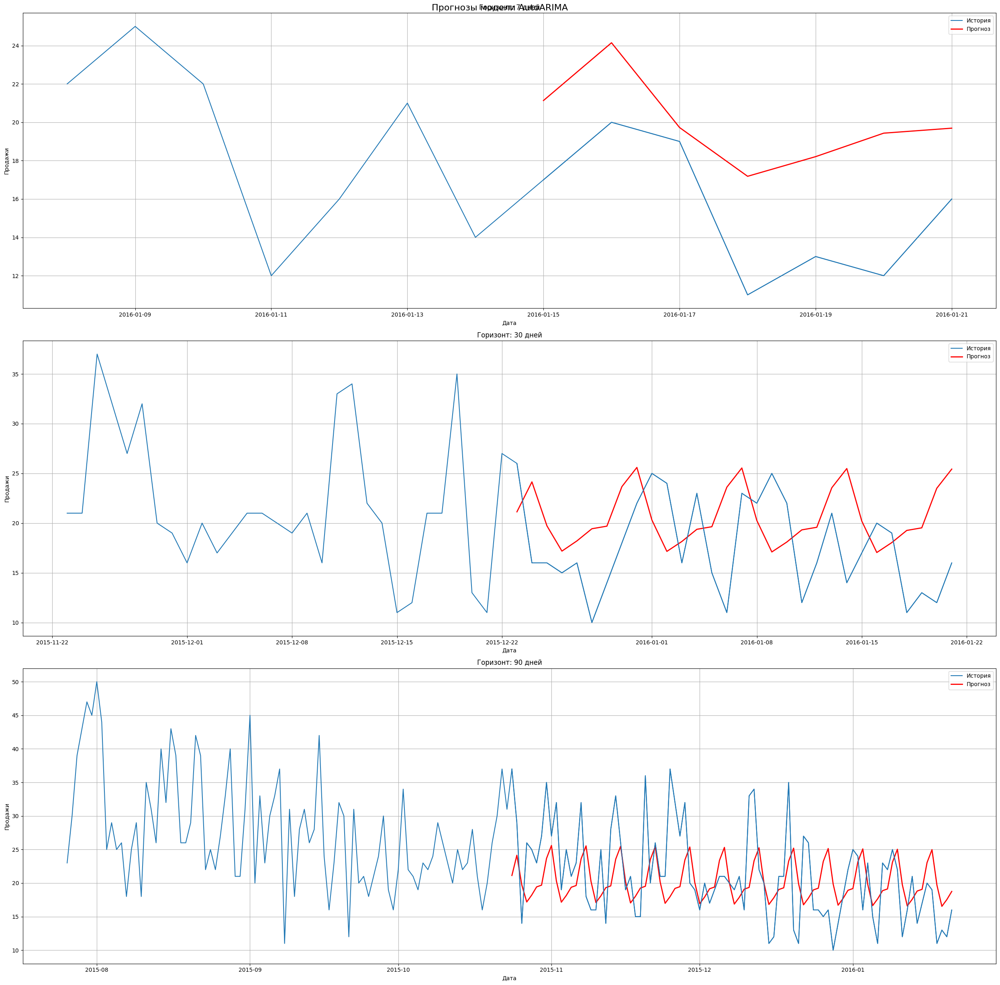

Model STL+ARIMA for horizon 7
Model STL+ARIMA for horizon 30
Model STL+ARIMA for horizon 90


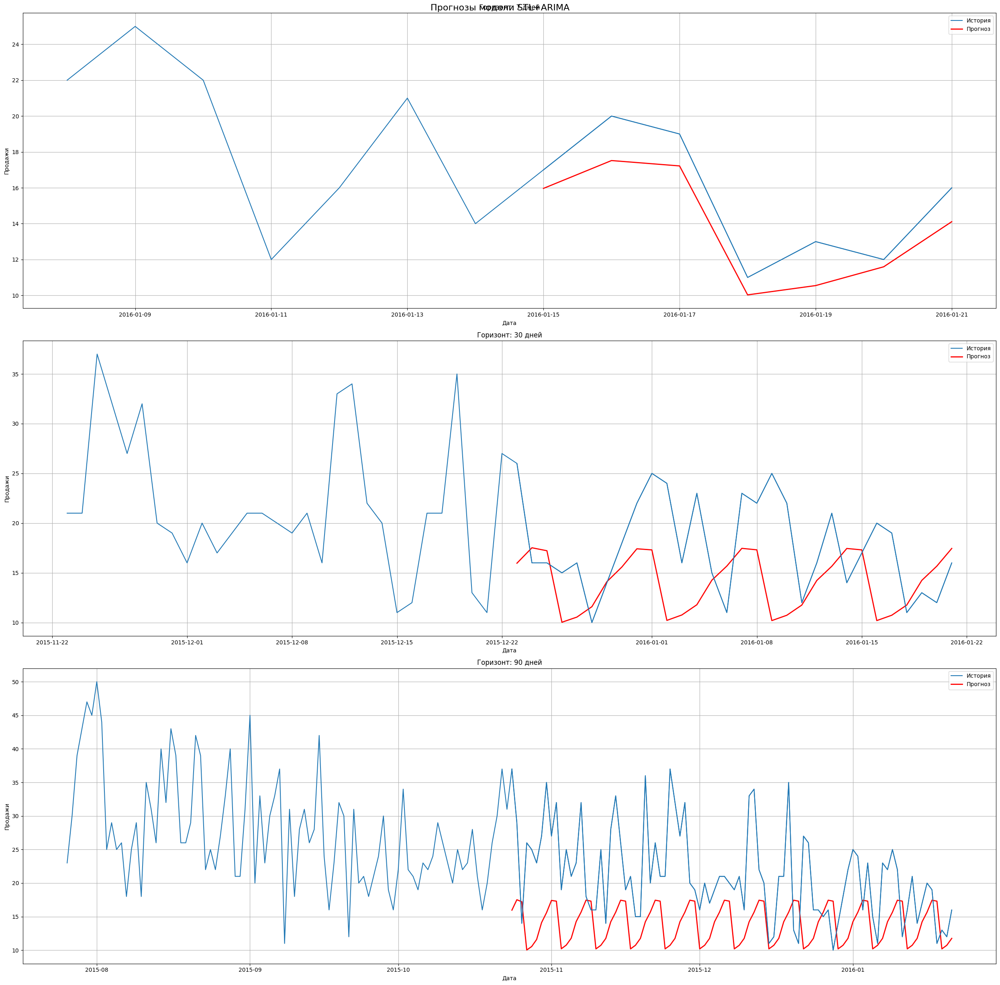

{('SARIMAX', 7): {'MAE': 18.27424880992937, 'MAPE (%)': 119.15709534867314, 'RMSE': 19.64614370153109}, ('SARIMAX', 30): {'MAE': 15.948353602423216, 'MAPE (%)': 99.9020330167427, 'RMSE': 17.269005133109992}, ('SARIMAX', 90): {'MAE': 13.373186494816622, 'MAPE (%)': 78.95623621943051, 'RMSE': 15.648549825794305}, ('AutoARIMA', 7): {'MAE': 4.503417564009286, 'MAPE (%)': 32.88113403273125, 'RMSE': 4.91430396659029}, ('AutoARIMA', 30): {'MAE': 5.4650416672442885, 'MAPE (%)': 36.361646922483985, 'RMSE': 6.301343670672365}, ('AutoARIMA', 90): {'MAE': 5.299078108991724, 'MAPE (%)': 26.14346757372319, 'RMSE': 6.660758735033067}, ('STL+ARIMA', 7): {'MAE': 1.5729296700165978, 'MAPE (%)': 10.10204744403546, 'RMSE': 1.7353087531137865}, ('STL+ARIMA', 30): {'MAE': 4.927914945916011, 'MAPE (%)': 25.348086606091453, 'RMSE': 6.42298133043046}, ('STL+ARIMA', 90): {'MAE': 8.184189394650597, 'MAPE (%)': 35.21274508786366, 'RMSE': 10.10995561946528}}
Product  STORE_1_727
{'trend': {'exists': True, 'p_value

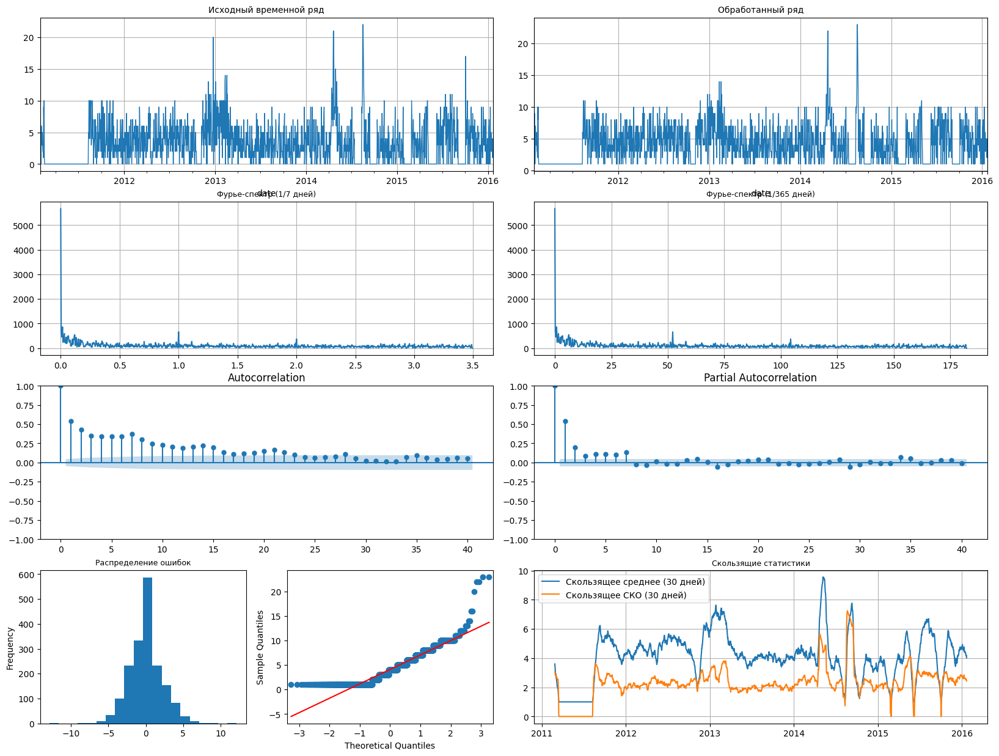

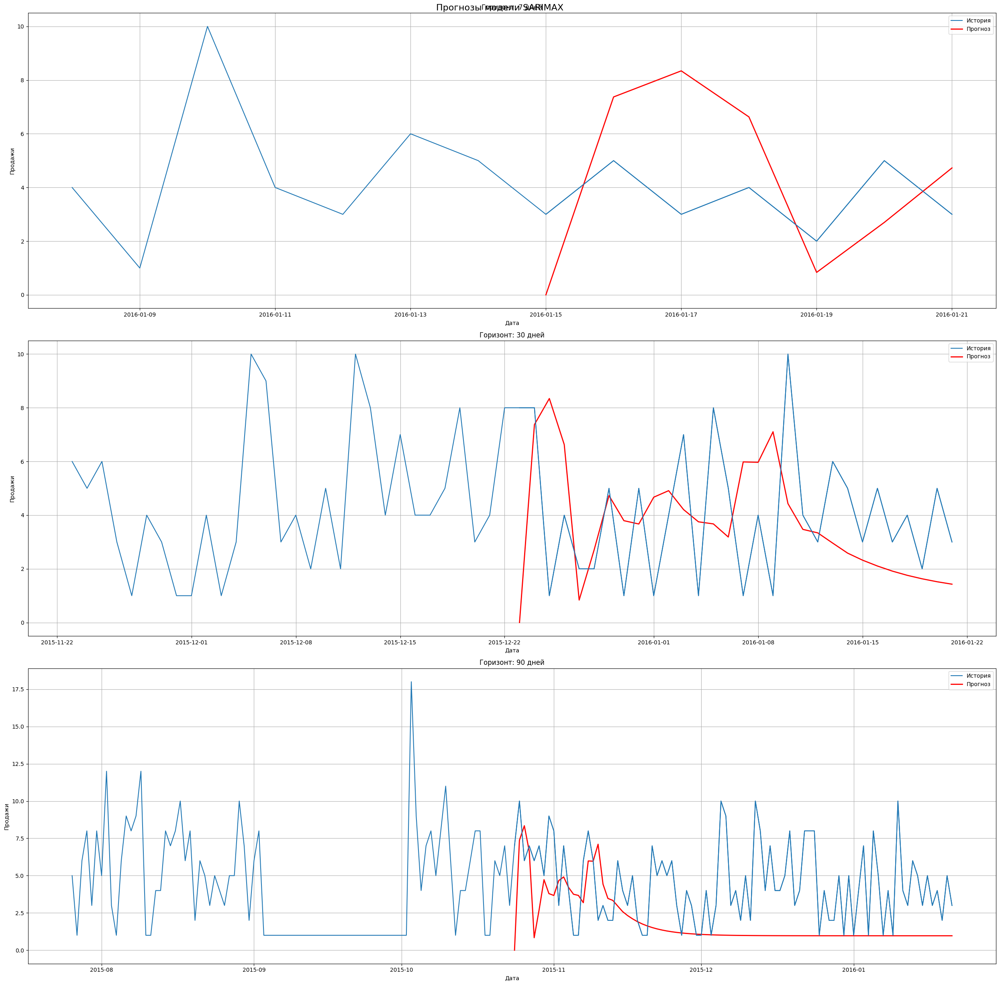

Model AutoARIMA for horizon 7

Best model:  ARIMA(0,0,2)(0,1,1)[7] intercept
Total fit time: 26.657 seconds
Model AutoARIMA for horizon 30

Best model:  ARIMA(0,0,2)(0,1,1)[7] intercept
Total fit time: 28.886 seconds
Model AutoARIMA for horizon 90

Best model:  ARIMA(0,0,2)(0,1,1)[7] intercept
Total fit time: 28.886 seconds


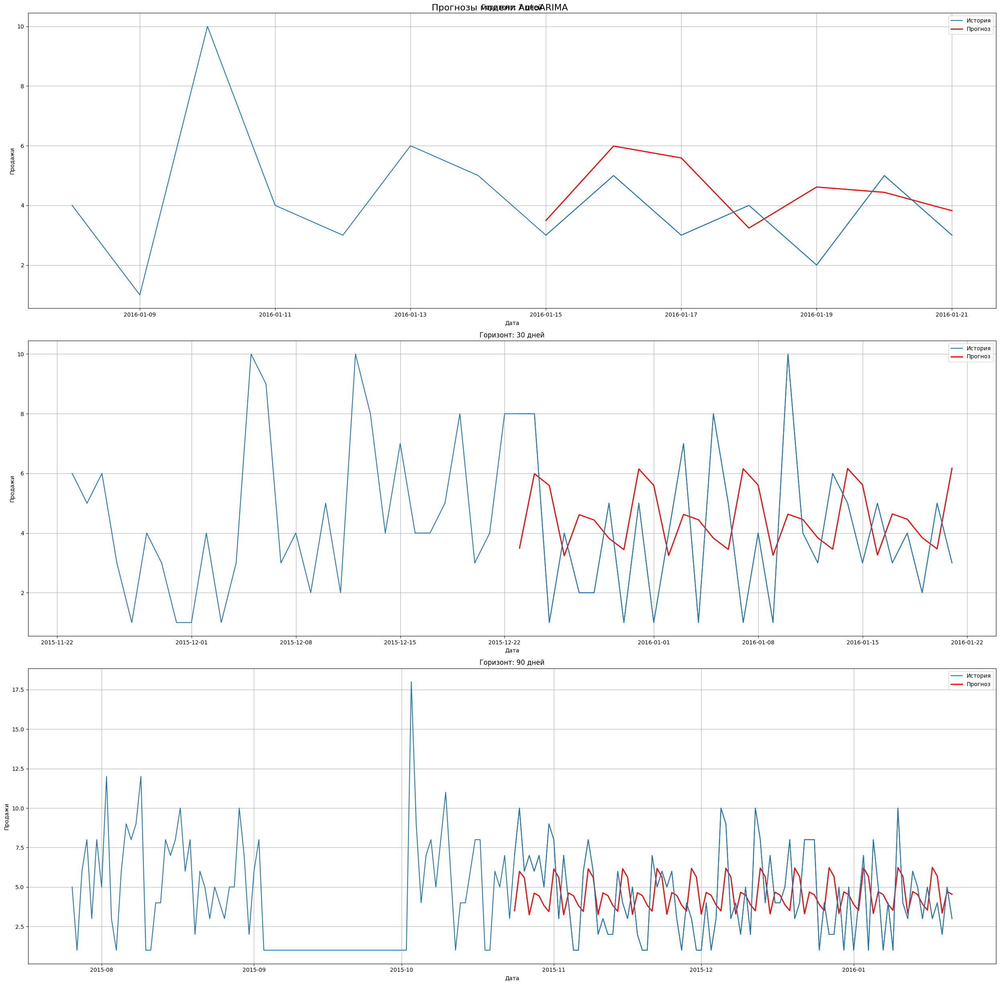

Model STL+ARIMA for horizon 7
Model STL+ARIMA for horizon 30
Model STL+ARIMA for horizon 90


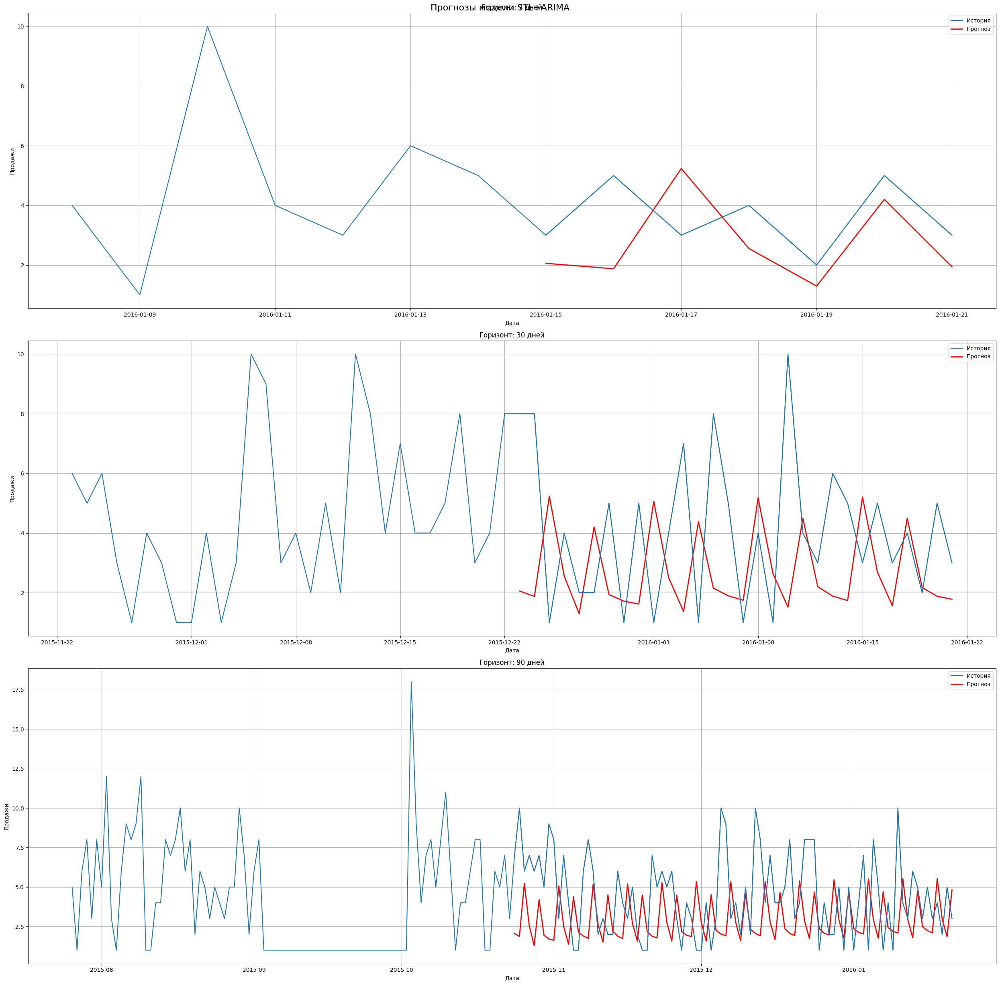

{('SARIMAX', 7): {'MAE': 2.6479810486313093, 'MAPE (%)': 79.00401514218044, 'RMSE': 2.920986803909589}, ('SARIMAX', 30): {'MAE': 2.613177563861605, 'MAPE (%)': 125.27127994603148, 'RMSE': 3.319854081294286}, ('SARIMAX', 90): {'MAE': 3.0331285035736983, 'MAPE (%)': 65.18221194474275, 'RMSE': 3.8321456889330725}, ('AutoARIMA', 7): {'MAE': 1.2620281457487832, 'MAPE (%)': 44.43397374360831, 'RMSE': 1.528342448973217}, ('AutoARIMA', 30): {'MAE': 2.3659240902182384, 'MAPE (%)': 113.3553813226051, 'RMSE': 2.750034644403831}, ('AutoARIMA', 90): {'MAE': 2.2798876490827618, 'MAPE (%)': 91.13056692888357, 'RMSE': 2.704666502338323}, ('STL+ARIMA', 7): {'MAE': 1.4735622127207326, 'MAPE (%)': 41.59750001659969, 'RMSE': 1.6904523426027984}, ('STL+ARIMA', 30): {'MAE': 2.767307746184479, 'MAPE (%)': 92.37683901996508, 'RMSE': 3.435271212578616}, ('STL+ARIMA', 90): {'MAE': 2.8197058492197735, 'MAPE (%)': 80.84594662037388, 'RMSE': 3.5191066263806072}}
 ARIMA(2,0,0)(0,1,0)[7] intercept   : AICC=4226.553,

In [ ]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)
for item in model.product_ids:
  model.full_analysis(item)

# TimeSeries
## Класс TimeSeriesAnalysis

Выполняет диагностику свойств временного ряда для лучшей настройки моделей и их анализа.

Методы анализа:

### Тренд:
Линейная регрессия с оценкой значимости (_analyze_trend).
Пример: p_value < 0.05 указывает на наличие дрифта.

### Сезонность:
Декомпозиция STL с оценкой амплитуды (_analyze_seasonality).
Обнаруживает недельные/годовые паттерны через спектральный анализ Фурье (_plot_fourier_spectrum).

### Стационарность:
Тесты ADF и KPSS (_analyze_stationarity).
Используется для автоматического выбора дифференцирования в моделях семейства ARIMA.

### Шумы и выбросы - предобработка данных:
Детекция через Isolation Forest + замена на скользящую медиану (_handle_outliers).
Анализ распределения остатков (_analyze_residuals).

### Визуализация:
Комплексные графики (тренд, спектр, ACF/PACF, скользящие статистики) для визуальной оценки структуры ряда и отчета

## Класс TimeSeriesClass

Инкапсулирует логику прогнозирования с поддержкой нескольких моделей.

### Модель (STL + ARIMA):
Декомпозиция на тренд, сезонность и остатки (hybrid_stl_arima).
Прогноз тренда и остатков через AutoARIMA + повторение сезонного паттерна.
Эффективна при отсутствии дрифта тренда на горизонте 7 дней.

### SARIMAX:
Параметры (p, d, q) выбираются на основе ACF/PACF из отчета (train_sarimax).
Помогает с учетом экзогенных переменных(праздники, цены).
Ограничение: Требует ручной настройки сезонных параметров.
Благодаря данным полученным после анализа дает качество лучше, чем с автоподбором у autoARIMA

### AutoARIMA:
Автоматический подбор параметров с проверкой сезонности (auto_arima_forecast).
Единственоое на длинных горизонтах может сходиться к среднему. Как и многие модели из семейства ARMA, поэтому самые простые реализации не использовала, а использовала либо настройку вручную либо дополняла компонентами, которые не давали сойтись прогнозу к среднему, а автоариму взяла чтобы посмотреть насколько хорошо параметры подбираются автоматически


## Адаптация под особенности ряда
Обработка выбросов: Изоляция аномалий + сглаживание через rolling median.
Динамический выбор модели: На основе отчетов о стационарности и сезонности.

В зависимости от горизонта тоже подойдут разные модели:
Для 7 дней: STL + ARIMA (хорошо ловит сезонность).
Для 30+ дней: SARIMAX с пересчетом параметров тренда.

### Используемые метрики:
MAE (Mean Absolute Error) - Средняя абсолютная ошибка:
    Показывает среднюю величину ошибки прогноза в абсолютных единицах измерения.
    Чем ближе к 0, тем лучше.

MAPE (Mean Absolute Percentage Error) - Средняя абсолютная процентная ошибка:
    Измеряет среднюю ошибку в процентах относительно фактических значений.
    Универсальная метрика для сравнения моделей на разных масштабах данных.

RMSE (Root Mean Square Error) - Корень из средней квадратичной ошибки:
    Учитывает большие ошибки сильнее, чем MAE. Полезен для выявления проблем с выбросами